# KVALITET PODATAKA - DATA QUALITY

#### Ovaj Jupyter notebook je deo seminarskog rada iz predmeta Predobrada i preprocesiranje podataka za mašinsko učenje kao praktični deo seminarskog rada

#### U njemu će biti predstavljeni praktični primeri na temu kvaliteta podataka što podrazumeva:

    - mere kvaliteta podataka
    - raspodelu podataka
    - korelaciju
    - varijansu 


In [208]:
import pandas as pd
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
import numpy as np
from sklearn.preprocessing import OneHotEncoder
from imblearn.over_sampling import SMOTE
from sklearn import preprocessing
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score, recall_score, precision_score, roc_curve, auc


In [209]:
data_project1 = pd.read_csv("data/ML_Project1 - Metro_Interstate_Traffic_Volume.csv")

In [210]:
data_project1.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
0,None,288.28,0.0,0.0,40,Clouds,scattered clouds,2012-10-02 09:00:00,5545
1,None,289.36,0.0,0.0,75,Clouds,broken clouds,2012-10-02 10:00:00,4516
2,None,289.58,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 11:00:00,4767
3,None,290.13,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 12:00:00,5026
4,None,291.14,0.0,0.0,75,Clouds,broken clouds,2012-10-02 13:00:00,4918


In [211]:
data_project1.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48204 entries, 0 to 48203
Data columns (total 9 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   holiday              48204 non-null  object 
 1   temp                 48204 non-null  float64
 2   rain_1h              48204 non-null  float64
 3   snow_1h              48204 non-null  float64
 4   clouds_all           48204 non-null  int64  
 5   weather_main         48204 non-null  object 
 6   weather_description  48204 non-null  object 
 7   date_time            48204 non-null  object 
 8   traffic_volume       48204 non-null  int64  
dtypes: float64(3), int64(2), object(4)
memory usage: 3.3+ MB


In [212]:
data_project1.isna().sum()

holiday                0
temp                   0
rain_1h                0
snow_1h                0
clouds_all             0
weather_main           0
weather_description    0
date_time              0
traffic_volume         0
dtype: int64

## Korišćenjem pandas, seaborn i matplotlib metoda

In [213]:
data_project1.describe()

,temp,rain_1h,snow_1h,clouds_all,traffic_volume
count,48204.000000,48204.000000,48204.000000,48204.000000,48204.000000
mean,281.205870,0.334264,0.000222,49.362231,3259.818355
std,13.338232,44.789133,0.008168,39.015750,1986.860670
min,0.000000,0.000000,0.000000,0.000000,0.000000
25%,272.160000,0.000000,0.000000,1.000000,1193.000000
50%,282.450000,0.000000,0.000000,64.000000,3380.000000
75%,291.806000,0.000000,0.000000,90.000000,4933.000000
max,310.070000,9831.300000,0.510000,100.000000,7280.000000


### Mere centralne tendencije

In [214]:
data_project1.mean(numeric_only=True)

temp               281.205870
rain_1h              0.334264
snow_1h              0.000222
clouds_all          49.362231
traffic_volume    3259.818355
dtype: float64

In [215]:
data_project1.median(numeric_only=True)

temp               282.45
rain_1h              0.00
snow_1h              0.00
clouds_all          64.00
traffic_volume    3380.00
dtype: float64

In [216]:
data_project1.mode(axis=0).head(1)

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
0,None,274.15,0.0,0.0,90.0,Clouds,sky is clear,2013-04-18 22:00:00,353


## Raspodela podataka

array([[<AxesSubplot:title={'center':'temp'}>,
        <AxesSubplot:title={'center':'rain_1h'}>],
       [<AxesSubplot:title={'center':'snow_1h'}>,
        <AxesSubplot:title={'center':'clouds_all'}>],
       [<AxesSubplot:title={'center':'traffic_volume'}>, <AxesSubplot:>]],
      dtype=object)

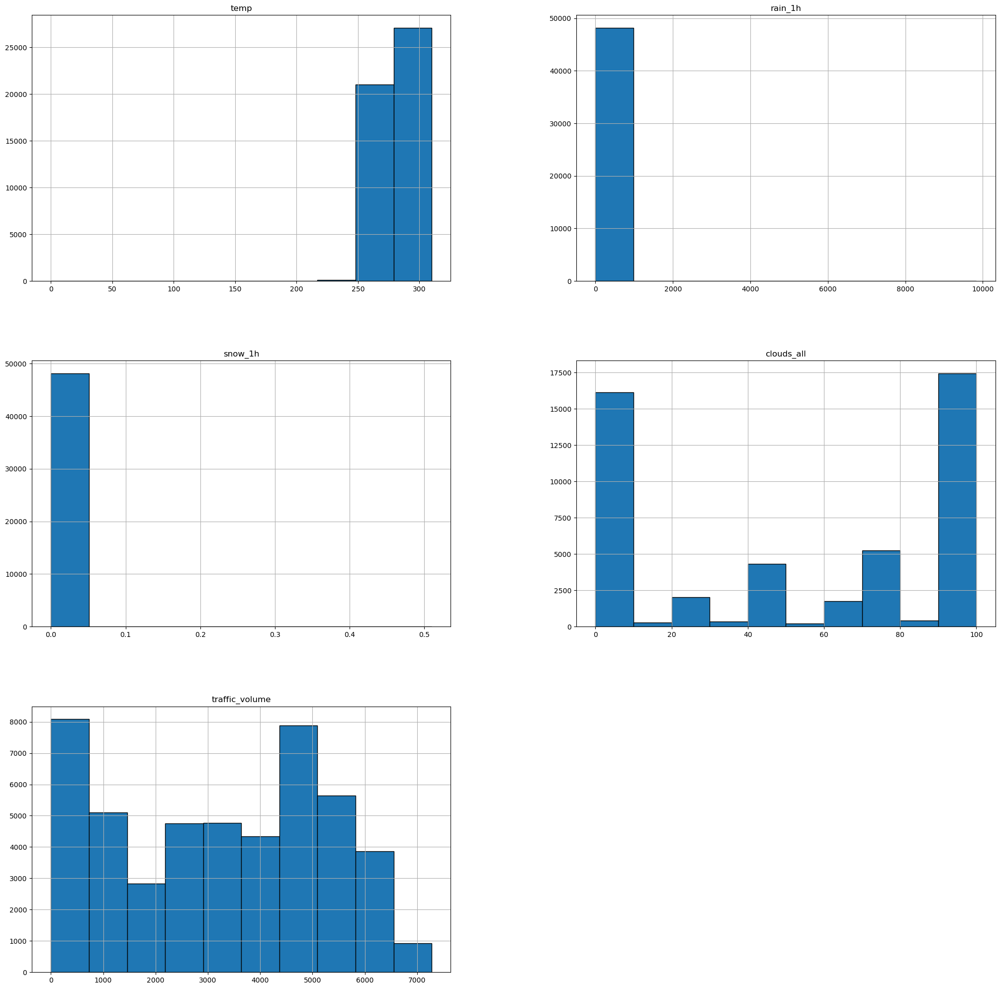

In [217]:
data_project1.hist(figsize = (25,25), edgecolor='black')


#### Traffic_volume atribut

<AxesSubplot:ylabel='Frequency'>

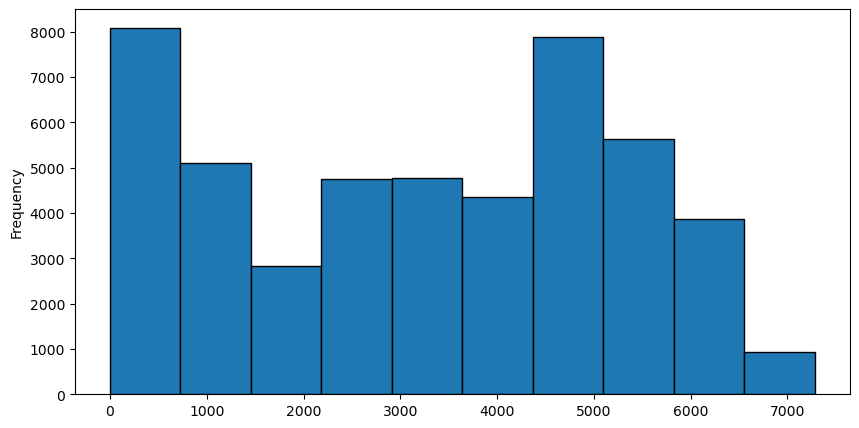

In [218]:
data_project1['traffic_volume'].plot(kind='hist', edgecolor='black', figsize=(10,5))


<AxesSubplot:xlabel='traffic_volume', ylabel='Count'>

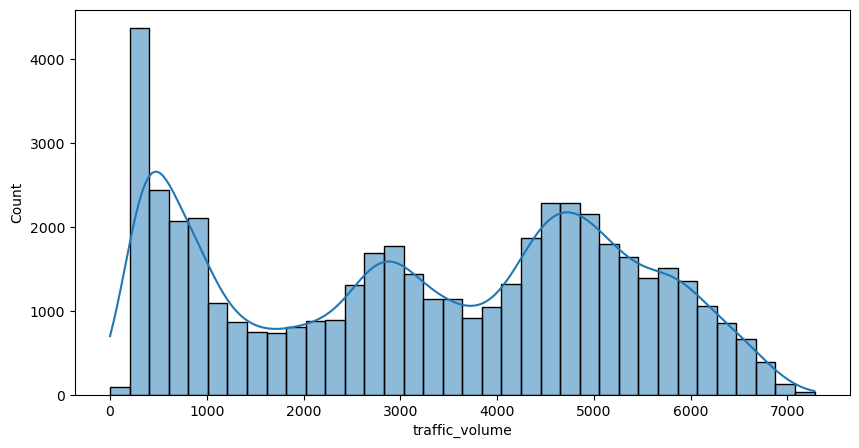

In [219]:
plt.figure(figsize=(10,5))
sns.histplot(data_project1['traffic_volume'], kde=True)

<AxesSubplot:ylabel='Density'>

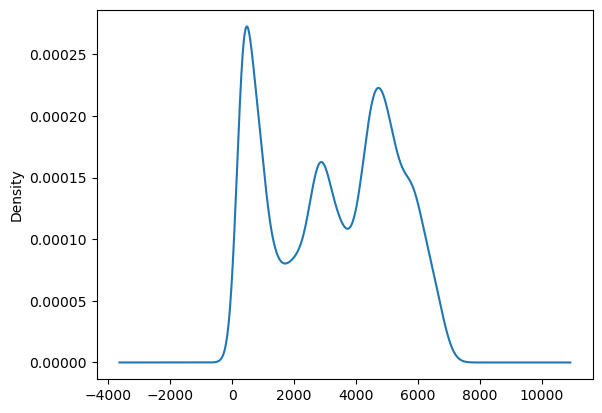

In [220]:
data_project1['traffic_volume'].plot(kind='density')#.set_xlim(-1000,8000)


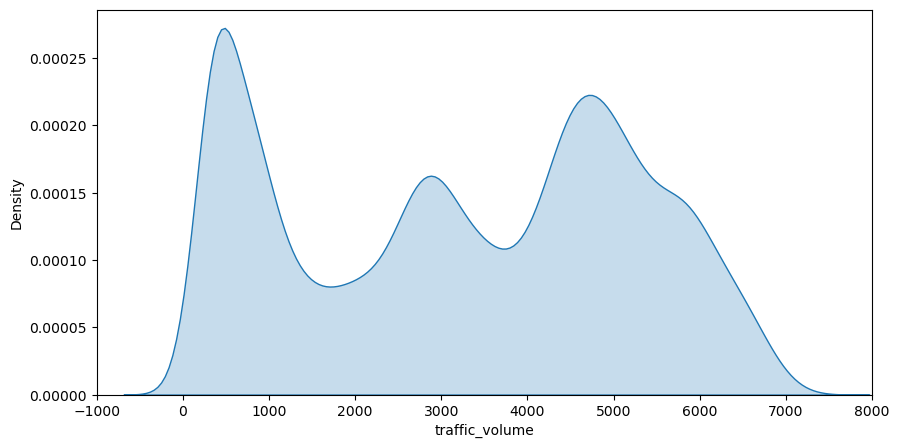

In [221]:
plt.figure(figsize=(10,5))
plt.xlim(-1000,8000)
plt.xlabel('traffic_volume')
plt.ylabel('Density')
sns.kdeplot(data_project1['traffic_volume'],shade=True)
plt.show()

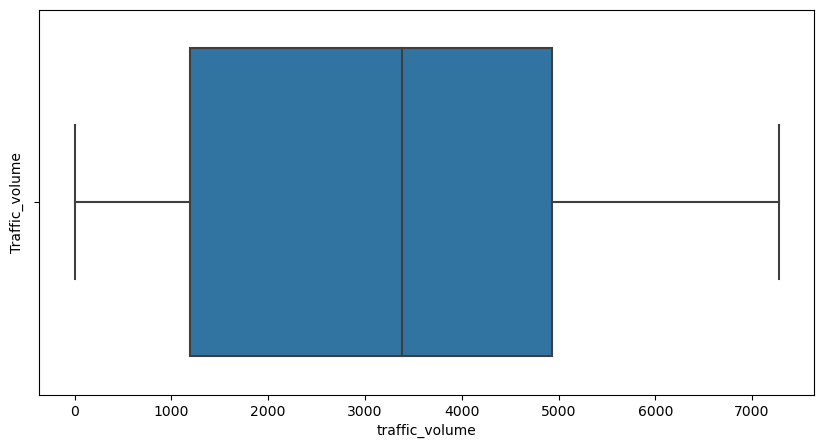

In [222]:
plt.figure(figsize=(10,5))
#plt.xlim(0,1000)
plt.ylabel('Traffic_volume')
sns.boxplot(x=data_project1['traffic_volume'])
plt.show()

#### PDF i CDF dijagrami

<AxesSubplot:xlabel='traffic_volume'>

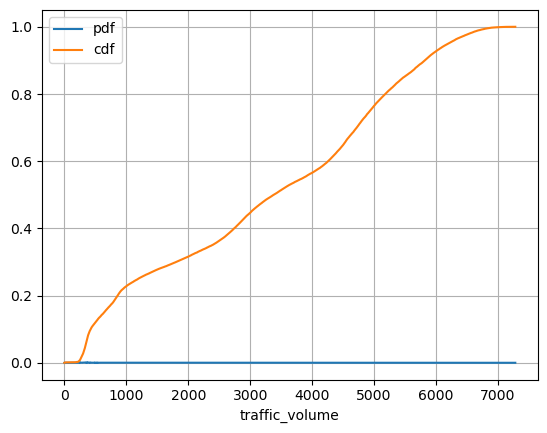

In [223]:
stats_df = data_project1 \
.groupby('traffic_volume') \
['traffic_volume'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'traffic_volume': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "traffic_volume",  y = ['pdf', 'cdf'], grid = True)


#### Temp atribut

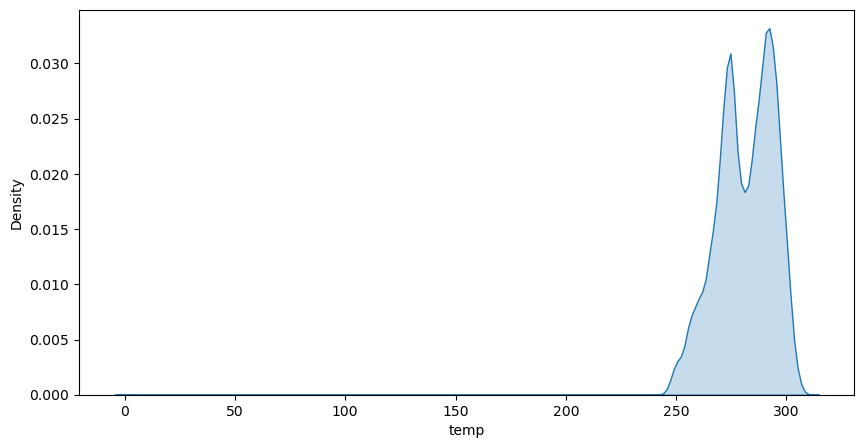

In [224]:
#data_project1['temp'].plot(kind='density')

plt.figure(figsize=(10,5))
# plt.xlim(-1000,8000)
plt.xlabel('temp')
plt.ylabel('Density')
sns.kdeplot(data_project1['temp'],shade=True)
plt.show()

<AxesSubplot:ylabel='Frequency'>

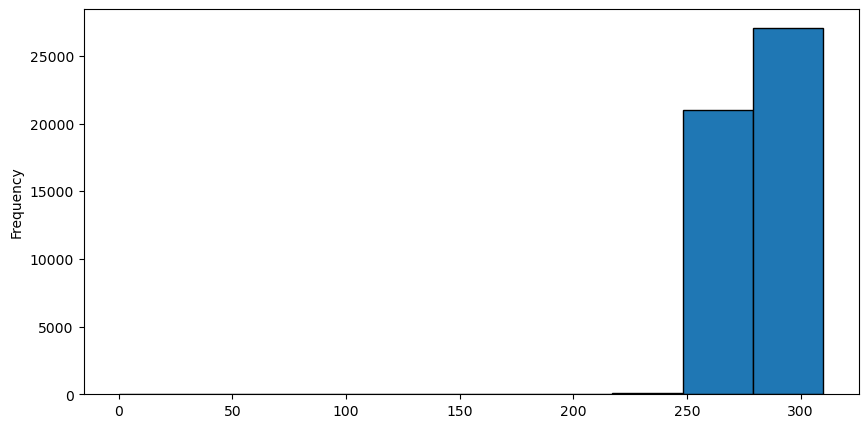

In [225]:
data_project1['temp'].plot(kind='hist', edgecolor='black', figsize=(10,5))


### PROVERA OUTLIER-A

In [260]:
outlier_data = data_project1.loc[data_project1['temp']>240].loc[data_project1['temp']<250]
#outlier_data = data_project1.loc[data_project1['temp']<260]
outlier_data.describe()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Drizzle,weather_main_Fog,weather_main_Rain,weather_main_Snow,weather_main_Thunderstorm,traffic_volume
count,347.000000,347.000000,347.0,347.0,347.000000,347.000000,347.000000,347.0,347.000000,347.0,347.000000,347.0,347.000000
mean,6.997118,248.435216,0.0,0.0,13.368876,0.703170,0.216138,0.0,0.054755,0.0,0.025937,0.0,2308.867435
std,0.053683,1.171065,0.0,0.0,25.191910,0.457521,0.412204,0.0,0.227830,0.0,0.159176,0.0,1873.383466
min,6.000000,243.390000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,194.000000
25%,7.000000,247.795000,0.0,0.0,1.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,662.500000
50%,7.000000,248.640000,0.0,0.0,1.000000,1.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,1872.000000
75%,7.000000,249.360000,0.0,0.0,5.000000,1.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,3725.500000
max,7.000000,249.990000,0.0,0.0,100.000000,1.000000,1.000000,0.0,1.000000,0.0,1.000000,0.0,6681.000000


In [261]:
outlier_data.head(10)

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Drizzle,weather_main_Fog,weather_main_Rain,weather_main_Snow,weather_main_Thunderstorm,traffic_volume
3099,7.0,248.14,0.0,0.0,25,0.0,1.0,0.0,0.0,0.0,0.0,0.0,719
3100,7.0,248.14,0.0,0.0,25,0.0,1.0,0.0,0.0,0.0,0.0,0.0,719
3101,7.0,248.14,0.0,0.0,25,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2424
3102,7.0,248.14,0.0,0.0,25,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2424
3103,7.0,249.46,0.0,0.0,40,0.0,1.0,0.0,0.0,0.0,0.0,0.0,6256
3104,7.0,249.33,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5693
3116,7.0,247.16,0.0,0.0,11,0.0,1.0,0.0,0.0,0.0,0.0,0.0,346
3117,7.0,247.16,0.0,0.0,11,0.0,1.0,0.0,0.0,0.0,0.0,0.0,248
3118,7.0,246.47,0.0,0.0,13,0.0,1.0,0.0,0.0,0.0,0.0,0.0,312
3119,7.0,246.47,0.0,0.0,13,0.0,1.0,0.0,0.0,0.0,0.0,0.0,737


In [262]:
outlier_data2 = data_project1.loc[data_project1['temp']<240]
outlier_data2.describe()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Drizzle,weather_main_Fog,weather_main_Rain,weather_main_Snow,weather_main_Thunderstorm,traffic_volume
count,10.0,10.0,10.0,10.0,10.0,10.0,10.0,10.0,10.0,10.0,10.0,10.0,10.000000
mean,7.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1318.200000
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1526.341727
min,7.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,284.000000
25%,7.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,379.250000
50%,7.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,736.500000
75%,7.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1493.000000
max,7.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,5150.000000


In [263]:
outlier_data2.head(10)

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Drizzle,weather_main_Fog,weather_main_Rain,weather_main_Snow,weather_main_Thunderstorm,traffic_volume
11898,7.0,0.0,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,361
11899,7.0,0.0,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,734
11900,7.0,0.0,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,2557
11901,7.0,0.0,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,5150
11946,7.0,0.0,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,291
11947,7.0,0.0,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,284
11948,7.0,0.0,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,434
11949,7.0,0.0,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,739
11950,7.0,0.0,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,962
11951,7.0,0.0,0.0,0.0,0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1670


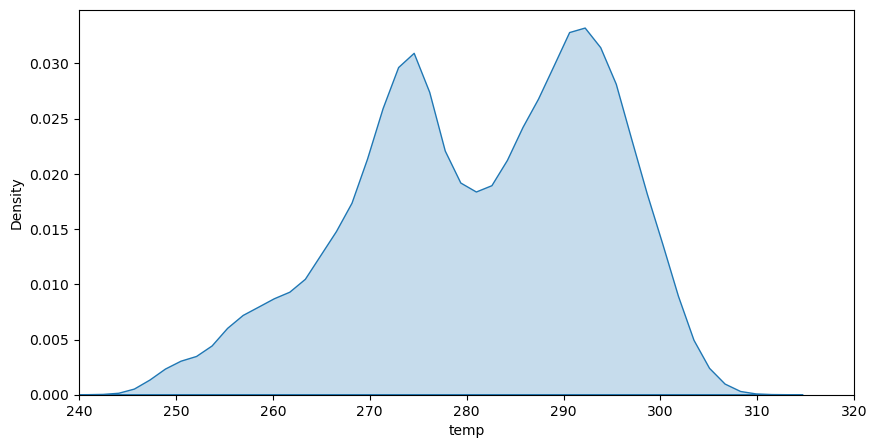

In [229]:
plt.figure(figsize=(10,5))
plt.xlim(240,320)
plt.xlabel('temp')
plt.ylabel('Density')
sns.kdeplot(data_project1['temp'],shade=True)
plt.show()

#### PDF i CDF grafici

<AxesSubplot:xlabel='temp'>

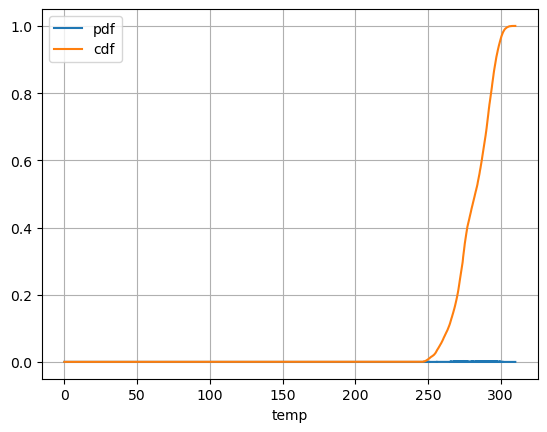

In [230]:
stats_df = data_project1 \
.groupby('temp') \
['temp'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'temp': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "temp",  y = ['pdf', 'cdf'], grid = True) #, xlim=(200,320))

#### Clouds All atribut sa tri vrha

<AxesSubplot:ylabel='Density'>

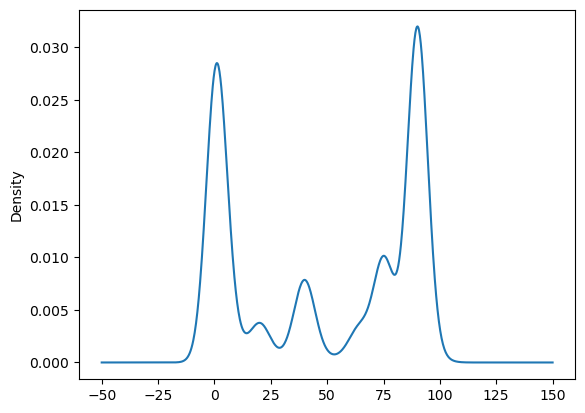

In [231]:
data_project1['clouds_all'].plot(kind='density')


#### Kategorički atributi

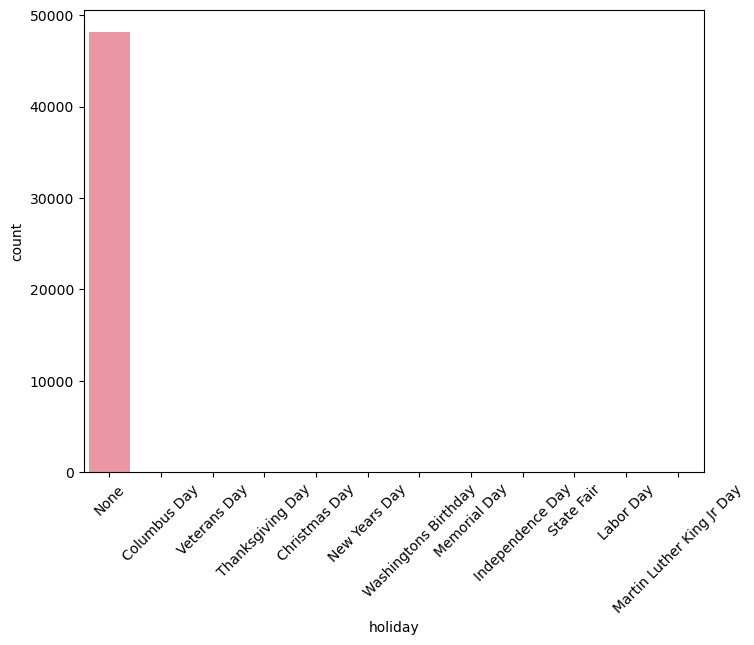

In [232]:
plt.figure(figsize=(8,6))
sns.countplot(x='holiday', data= data_project1)
plt.xticks(rotation=45)
plt.show()

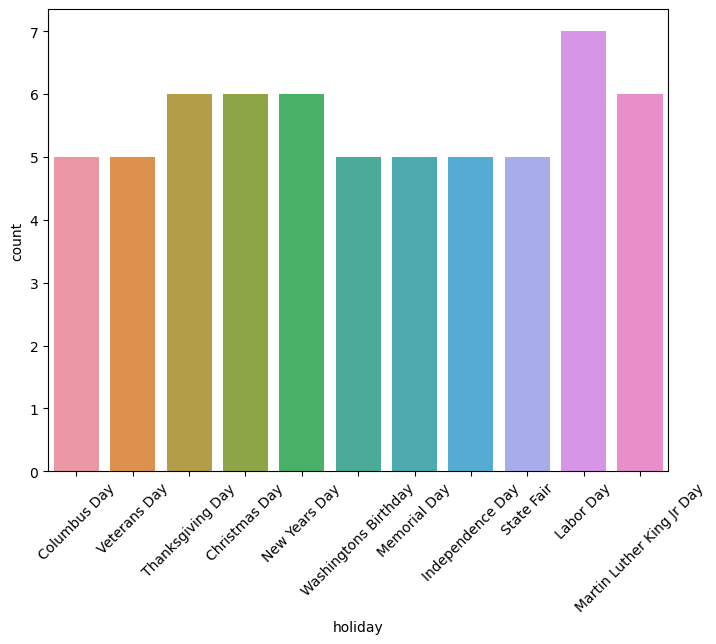

In [233]:
holidays = data_project1.loc[data_project1['holiday'] != 'None']
plt.figure(figsize=(8,6))
sns.countplot(x='holiday', data= holidays)
plt.xticks(rotation=45)
plt.show()

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

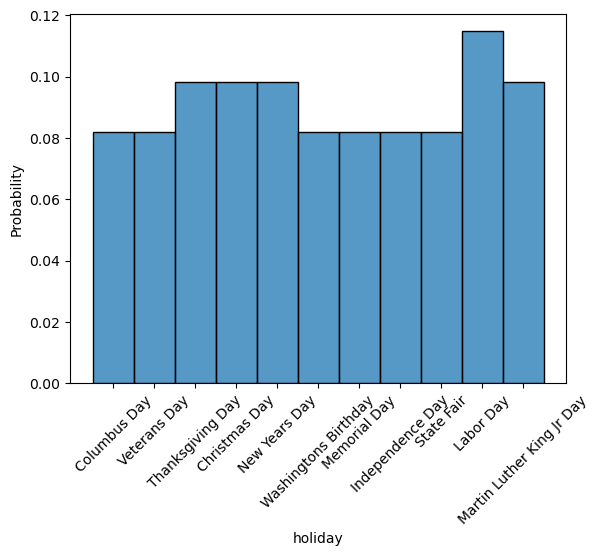

In [234]:
holiday_data = data_project1.loc[data_project1['holiday'] != 'None']['holiday']
sns.histplot(holiday_data, stat='probability')
plt.xticks(rotation=45)

<AxesSubplot:xlabel='count', ylabel='weather_main'>

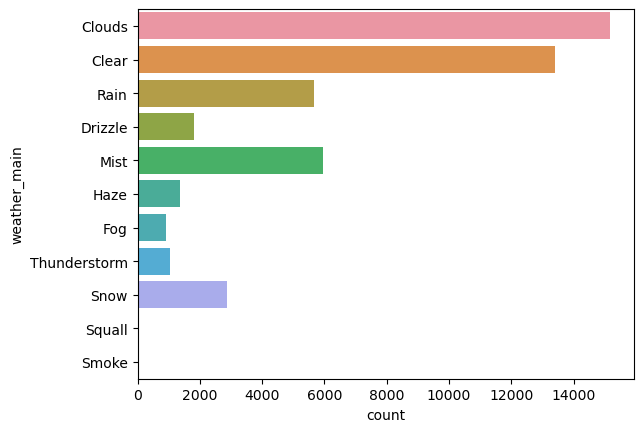

In [235]:
sns.countplot(y='weather_main', data=data_project1)

## Matrica korelacije

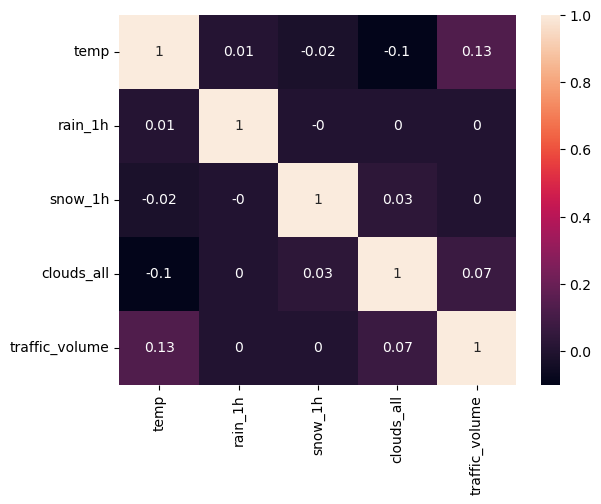

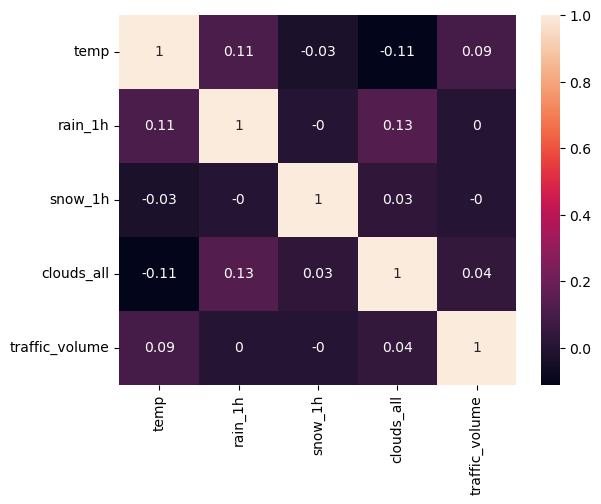

In [236]:
matrix = data_project1.corr(method='pearson').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

matrix = data_project1.corr(method='kendall').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

## Varijansa i standardna devijacija

In [237]:
data_project1.var(numeric_only=True).round(2)

temp                  177.91
rain_1h              2006.07
snow_1h                 0.00
clouds_all           1522.23
traffic_volume    3947615.32
dtype: float64

In [238]:
data_project1.std(numeric_only=True).round(2)

temp                13.34
rain_1h             44.79
snow_1h              0.01
clouds_all          39.02
traffic_volume    1986.86
dtype: float64

#### Korišćenjem ProfileReport klase

In [239]:
project1_report = ProfileReport(data_project1)

#### EDA analiza Projekta 1

In [240]:
project1_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### UTICAJ RASPODELE PODATAKA I ZAVISNOSTI IZMEĐU PODATAKA NA REZULTATE ALGORITAMA MAŠINSKOG UČENJA

#### Pretprocesiranje skupa podataka

In [241]:
data_project1.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main,weather_description,date_time,traffic_volume
0,None,288.28,0.0,0.0,40,Clouds,scattered clouds,2012-10-02 09:00:00,5545
1,None,289.36,0.0,0.0,75,Clouds,broken clouds,2012-10-02 10:00:00,4516
2,None,289.58,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 11:00:00,4767
3,None,290.13,0.0,0.0,90,Clouds,overcast clouds,2012-10-02 12:00:00,5026
4,None,291.14,0.0,0.0,75,Clouds,broken clouds,2012-10-02 13:00:00,4918


In [242]:
data_project1.drop(columns = ['date_time', "weather_description"],inplace = True)

In [243]:
data_project1.loc[data_project1['weather_main'].str.contains('Haze'),'weather_main'] = 'Fog'   
data_project1.loc[data_project1['weather_main'].str.contains('Mist'),'weather_main'] = 'Fog'   
data_project1.loc[data_project1['weather_main'].str.contains('Smoke'),'weather_main'] = 'Fog'   
data_project1.loc[data_project1['weather_main'].str.contains('Squall'),'weather_main'] = 'Thunderstorm'       
data_project1['weather_main'].value_counts()

Clouds          15164
Clear           13391
Fog              8242
Rain             5672
Snow             2876
Drizzle          1821
Thunderstorm     1038
Name: weather_main, dtype: int64

#### Enkodiranje kategoričkih vrednosti

In [244]:
from sklearn.preprocessing import OrdinalEncoder
enc = OrdinalEncoder()
data_project1["holiday"] = enc.fit_transform(data_project1[["holiday"]])

#data_project1[['holiday']] = ordinal_encoder.fit_transform(data_project1[['holiday']])


In [245]:
data_project1['weather_main'].value_counts()

Clouds          15164
Clear           13391
Fog              8242
Rain             5672
Snow             2876
Drizzle          1821
Thunderstorm     1038
Name: weather_main, dtype: int64

In [246]:
from sklearn.preprocessing import OneHotEncoder

OH_encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)
OH_cols = pd.DataFrame(OH_encoder.fit_transform(data_project1[['weather_main']]))

# One-hot encoding removed index; put it back
OH_cols.index = data_project1.index
column_name = OH_encoder.get_feature_names_out(['weather_main'])
OH_cols.columns = column_name

# Remove categorical columns (will replace with one-hot encoding)
num_X = data_project1.drop(['weather_main'], axis=1)
OH_X = pd.concat([num_X, OH_cols], axis=1)
#one_hot_encoded_frame = pd.DataFrame.sparse.from_spmatrix(OH_X, columns= column_name)

data_project1=OH_X
OH_cols = pd.DataFrame(data_project1[['traffic_volume']])
num_X = data_project1.drop("traffic_volume", axis=1)
Odf_X = pd.concat([num_X, OH_cols], axis=1)
data_project1=Odf_X
data_project1.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Drizzle,weather_main_Fog,weather_main_Rain,weather_main_Snow,weather_main_Thunderstorm,traffic_volume
0,7.0,288.28,0.0,0.0,40,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5545
1,7.0,289.36,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4516
2,7.0,289.58,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4767
3,7.0,290.13,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5026
4,7.0,291.14,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4918


In [247]:
data_project1.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Drizzle,weather_main_Fog,weather_main_Rain,weather_main_Snow,weather_main_Thunderstorm,traffic_volume
0,7.0,288.28,0.0,0.0,40,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5545
1,7.0,289.36,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4516
2,7.0,289.58,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4767
3,7.0,290.13,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5026
4,7.0,291.14,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4918


#### Matrica korelacije osnovnog skupa

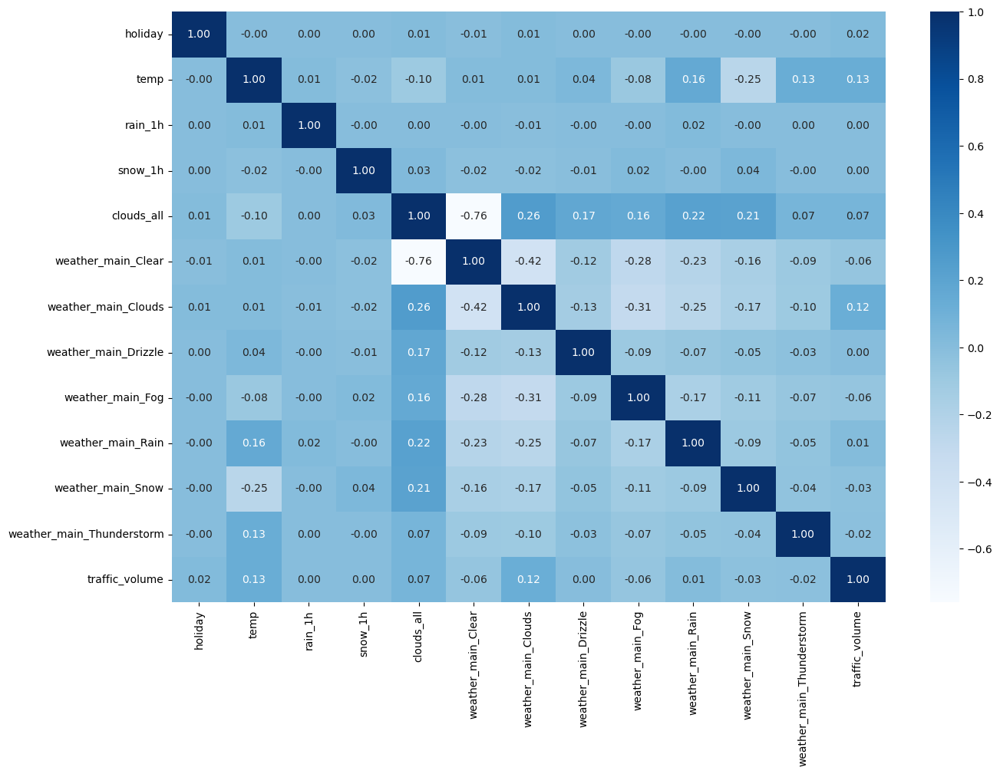

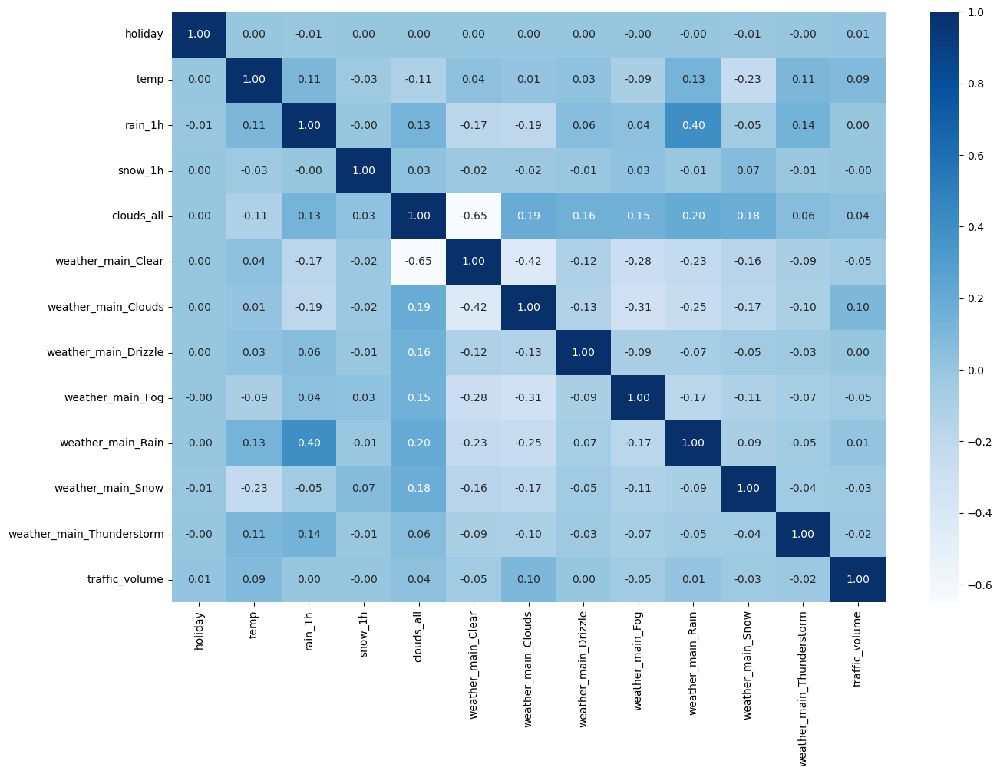

In [248]:
fig, ax = plt.subplots(figsize=(15,10))   
sns.heatmap(data_project1.corr(method='pearson').round(2), annot = True , fmt=".2f",ax=ax ,cmap = "Blues")
plt.show()

fig, ax = plt.subplots(figsize=(15,10))   
sns.heatmap(data_project1.corr(method='kendall').round(2), annot = True , fmt=".2f",ax=ax ,cmap = "Blues")
plt.show()

array([[<AxesSubplot:title={'center':'holiday'}>,
        <AxesSubplot:title={'center':'temp'}>,
        <AxesSubplot:title={'center':'rain_1h'}>,
        <AxesSubplot:title={'center':'snow_1h'}>],
       [<AxesSubplot:title={'center':'clouds_all'}>,
        <AxesSubplot:title={'center':'weather_main_Clear'}>,
        <AxesSubplot:title={'center':'weather_main_Clouds'}>,
        <AxesSubplot:title={'center':'weather_main_Drizzle'}>],
       [<AxesSubplot:title={'center':'weather_main_Fog'}>,
        <AxesSubplot:title={'center':'weather_main_Rain'}>,
        <AxesSubplot:title={'center':'weather_main_Snow'}>,
        <AxesSubplot:title={'center':'weather_main_Thunderstorm'}>],
       [<AxesSubplot:title={'center':'traffic_volume'}>, <AxesSubplot:>,
        <AxesSubplot:>, <AxesSubplot:>]], dtype=object)

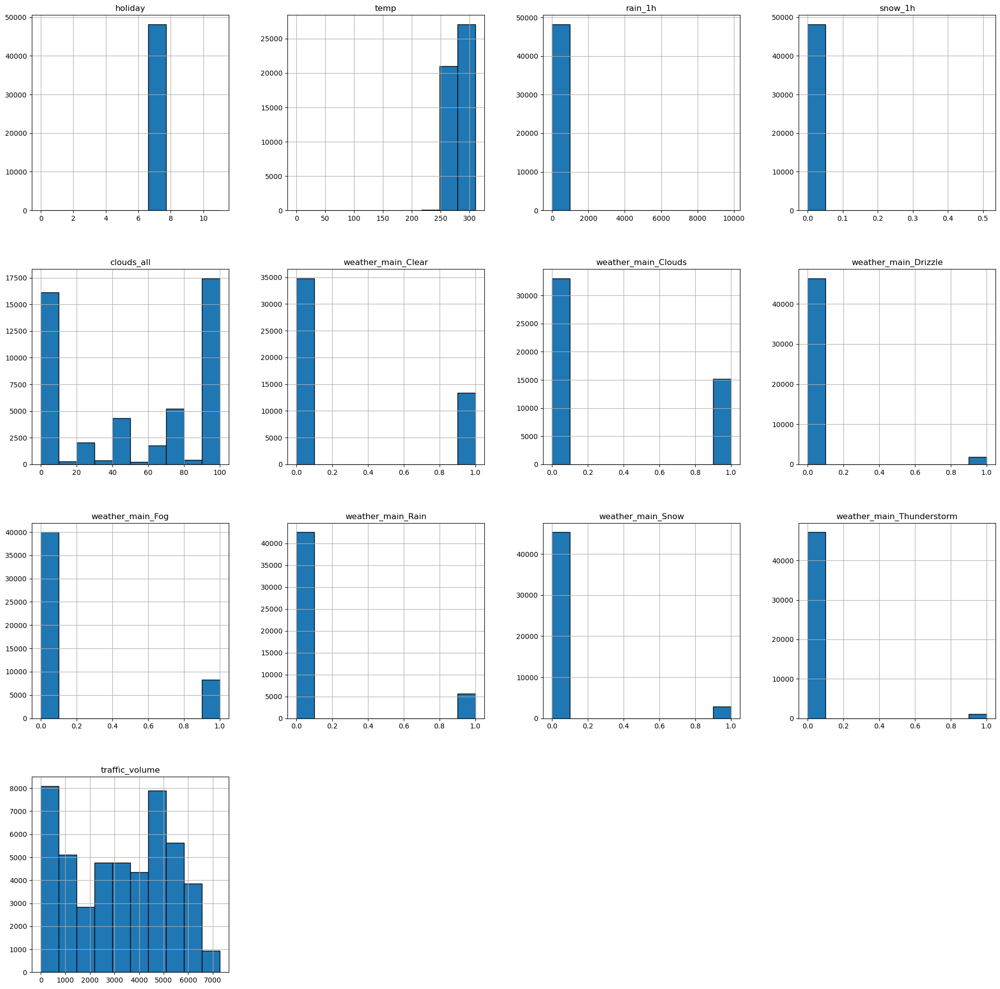

In [264]:
data_project1.hist(figsize = (25,25), edgecolor='black')


### Provera rain_1h atributa

In [272]:
rain_ispod_1 = data_project1.loc[data_project1['rain_1h']<1.0]
print(rain_ispod_1.value_counts())
rain_ispod_1.head()

holiday  temp     rain_1h  snow_1h  clouds_all  weather_main_Clear  weather_main_Clouds  weather_main_Drizzle  weather_main_Fog  weather_main_Rain  weather_main_Snow  weather_main_Thunderstorm  traffic_volume
7.0      274.710  0.0      0.0      90          0.0                 0.0                  0.0                   1.0               0.0                0.0                0.0                        388               4
         290.680  0.0      0.0      20          0.0                 0.0                  0.0                   1.0               0.0                0.0                0.0                        6007              3
         268.680  0.0      0.0      90          0.0                 0.0                  0.0                   1.0               0.0                0.0                0.0                        4399              3
         281.280  0.0      0.0      90          0.0                 0.0                  0.0                   1.0               0.0                0

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Drizzle,weather_main_Fog,weather_main_Rain,weather_main_Snow,weather_main_Thunderstorm,traffic_volume
0,7.0,288.28,0.0,0.0,40,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5545
1,7.0,289.36,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4516
2,7.0,289.58,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4767
3,7.0,290.13,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5026
4,7.0,291.14,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4918


In [274]:
rain_iznad_1 = data_project1.loc[data_project1['rain_1h']>1.0]
print(rain_iznad_1.value_counts())
rain_iznad_1.head()


holiday  temp    rain_1h  snow_1h  clouds_all  weather_main_Clear  weather_main_Clouds  weather_main_Drizzle  weather_main_Fog  weather_main_Rain  weather_main_Snow  weather_main_Thunderstorm  traffic_volume
7.0      294.16  5.59     0.0      1           0.0                 0.0                  0.0                   1.0               0.0                0.0                0.0                        6006              3
         293.22  4.57     0.0      90          0.0                 0.0                  0.0                   1.0               0.0                0.0                0.0                        5205              3
         290.90  9.62     0.0      90          0.0                 0.0                  0.0                   1.0               0.0                0.0                0.0                        3898              3
         291.48  1.78     0.0      90          0.0                 0.0                  0.0                   1.0               0.0                0.0   

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Drizzle,weather_main_Fog,weather_main_Rain,weather_main_Snow,weather_main_Thunderstorm,traffic_volume
6743,7.0,287.82,2.16,0.0,56,0.0,0.0,0.0,0.0,1.0,0.0,0.0,6744
6744,7.0,287.82,2.16,0.0,56,0.0,0.0,0.0,1.0,0.0,0.0,0.0,6744
6745,7.0,287.37,3.39,0.0,56,0.0,0.0,0.0,0.0,1.0,0.0,0.0,6419
6746,7.0,287.37,3.39,0.0,56,0.0,0.0,0.0,1.0,0.0,0.0,0.0,6419
6840,7.0,286.94,1.29,0.0,68,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2717


<AxesSubplot:xlabel='rain_1h', ylabel='Count'>

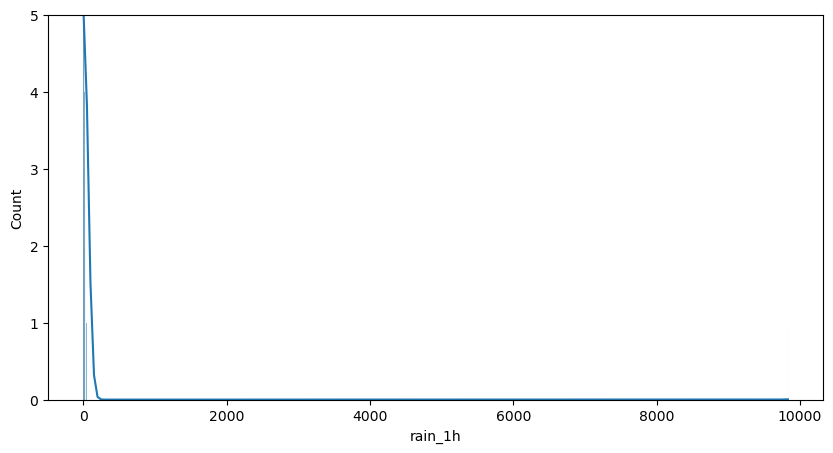

In [276]:
plt.figure(figsize=(10,5))
plt.ylim(0,5)

sns.histplot(rain_iznad_1['rain_1h'], kde=True)

In [295]:
rain_iznad_1['rain_1h'].value_counts()

1.02    123
1.78     91
1.52     69
1.27     50
2.79     29
       ... 
1.90      1
3.25      1
1.53      1
3.12      1
1.59      1
Name: rain_1h, Length: 300, dtype: int64

### Feature importance

Feature: snow_1h, Score: 0.00152
Feature: holiday, Score: 0.00193
Feature: weather_main_Clear, Score: 0.00325
Feature: weather_main_Thunderstorm, Score: 0.00359
Feature: weather_main_Snow, Score: 0.00366
Feature: weather_main_Drizzle, Score: 0.00462
Feature: weather_main_Clouds, Score: 0.00518
Feature: weather_main_Rain, Score: 0.00711
Feature: weather_main_Fog, Score: 0.01174
Feature: rain_1h, Score: 0.04942
Feature: clouds_all, Score: 0.11956
Feature: temp, Score: 0.78841


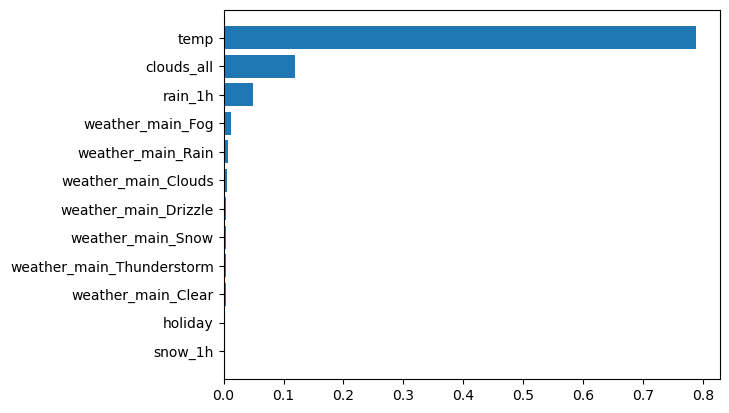

In [288]:
from matplotlib import pyplot

model = DecisionTreeRegressor()

y = data_project1.traffic_volume
df_withoutTrafficVolume = data_project1.loc[:, data_project1.columns != 'traffic_volume']
X = data_project1[df_withoutTrafficVolume.columns]
# fit the model
model.fit(X, y)
# get importance
importance = sorted(zip(model.feature_importances_, X.columns), key = lambda x: x[0])

# summarize feature importance
for coef, feat in importance:
 print('Feature: %s, Score: %.5f' % (feat, coef))
# plot feature importance
pyplot.barh([x[1] for x in importance], [x[0] for x in importance])
pyplot.show()


## Filtrirani skup podataka na osnovu raspodele podataka
### Na osnovu raspodele podataka utvrđeno je da se mogu izbaciti:
####    - redovi sa $rain\_1h$ > 1.0
####    - celokupna kolona $holiday$ obzirom da je nebalansirana
####    - redovi sa $temp$ < 240
####    - celokupne kolone $weather\_main\_Drizzle$, $weather\_main\_Rain$, $weather\_main\_Snow$ i $weather\_main\_Thunderstorm$ obzirom da su nebalansirane

In [282]:
data_project1.describe()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Drizzle,weather_main_Fog,weather_main_Rain,weather_main_Snow,weather_main_Thunderstorm,traffic_volume
count,48204.000000,48204.000000,48204.000000,48204.000000,48204.000000,48204.000000,48204.000000,48204.000000,48204.000000,48204.000000,48204.000000,48204.000000,48204.000000
mean,6.997780,281.205870,0.334264,0.000222,49.362231,0.277799,0.314580,0.037777,0.170982,0.117667,0.059663,0.021533,3259.818355
std,0.139999,13.338232,44.789133,0.008168,39.015750,0.447918,0.464353,0.190658,0.376497,0.322216,0.236864,0.145156,1986.860670
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,7.000000,272.160000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1193.000000
50%,7.000000,282.450000,0.000000,0.000000,64.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3380.000000
75%,7.000000,291.806000,0.000000,0.000000,90.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4933.000000
max,11.000000,310.070000,9831.300000,0.510000,100.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,7280.000000


In [279]:
data_project1_filtered_by_dist = data_project1.copy()

data_project1_filtered_by_dist = data_project1_filtered_by_dist.loc[data_project1['rain_1h']<1.0]

data_project1_filtered_by_dist = data_project1_filtered_by_dist.loc[data_project1['temp']>240]

data_project1_filtered_by_dist.drop(columns = ['holiday', 'weather_main_Drizzle', 'weather_main_Rain', 'weather_main_Snow', 'weather_main_Thunderstorm'], inplace = True)

In [281]:
data_project1_filtered_by_dist.describe()


,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Fog,traffic_volume
count,46783.000000,46783.000000,46783.000000,46783.000000,46783.000000,46783.000000,46783.000000,46783.000000
mean,281.012606,0.018062,0.000229,48.585918,0.286023,0.324135,0.168908,3265.366479
std,12.761052,0.094505,0.008291,39.050981,0.451905,0.468056,0.374674,1986.641657
min,243.390000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,271.950000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1203.000000
50%,281.840000,0.000000,0.000000,64.000000,0.000000,0.000000,0.000000,3388.000000
75%,291.640000,0.000000,0.000000,90.000000,1.000000,1.000000,0.000000,4935.500000
max,310.070000,0.980000,0.510000,100.000000,1.000000,1.000000,1.000000,7280.000000


In [280]:
data_project1_filtered_by_dist.head()

,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Fog,traffic_volume
0,288.28,0.0,0.0,40,0.0,1.0,0.0,5545
1,289.36,0.0,0.0,75,0.0,1.0,0.0,4516
2,289.58,0.0,0.0,90,0.0,1.0,0.0,4767
3,290.13,0.0,0.0,90,0.0,1.0,0.0,5026
4,291.14,0.0,0.0,75,0.0,1.0,0.0,4918


#### Matrica korelacije filtriranog skupa na osnovu na osnovu raspodele podataka

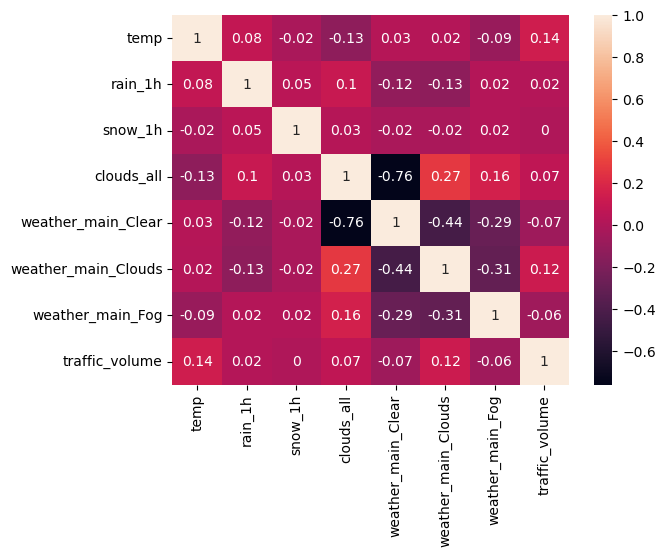

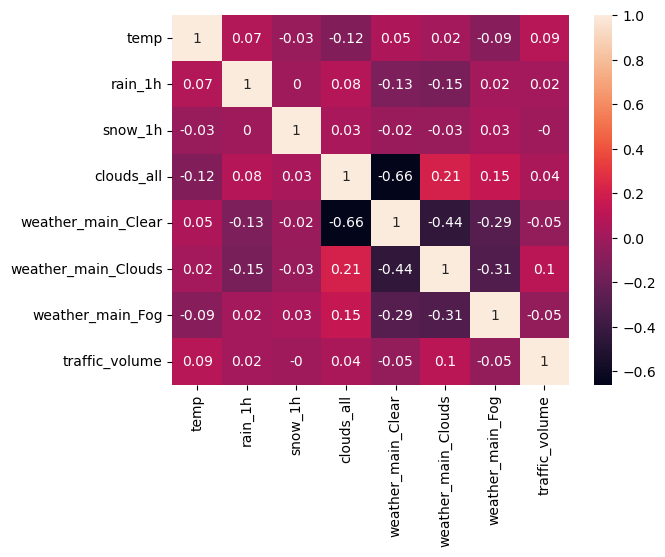

In [283]:
matrix = data_project1_filtered_by_dist.corr(method='pearson').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

matrix = data_project1_filtered_by_dist.corr(method='kendall').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

## Filtrirani skup podataka na osnovu matrice korelacije

In [250]:
data_project1_filtered = data_project1.copy()
#data_project1_filtered.head()
data_project1_filtered.drop(columns = ['rain_1h','snow_1h', 'holiday', 'weather_main_Drizzle', 'weather_main_Thunderstorm', 'weather_main_Rain'],inplace = True)

In [251]:
data_project1.head()

,holiday,temp,rain_1h,snow_1h,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Drizzle,weather_main_Fog,weather_main_Rain,weather_main_Snow,weather_main_Thunderstorm,traffic_volume
0,7.0,288.28,0.0,0.0,40,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5545
1,7.0,289.36,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4516
2,7.0,289.58,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4767
3,7.0,290.13,0.0,0.0,90,0.0,1.0,0.0,0.0,0.0,0.0,0.0,5026
4,7.0,291.14,0.0,0.0,75,0.0,1.0,0.0,0.0,0.0,0.0,0.0,4918


In [252]:
data_project1_filtered.head()

,temp,clouds_all,weather_main_Clear,weather_main_Clouds,weather_main_Fog,weather_main_Snow,traffic_volume
0,288.28,40,0.0,1.0,0.0,0.0,5545
1,289.36,75,0.0,1.0,0.0,0.0,4516
2,289.58,90,0.0,1.0,0.0,0.0,4767
3,290.13,90,0.0,1.0,0.0,0.0,5026
4,291.14,75,0.0,1.0,0.0,0.0,4918


#### Matrica korelacije filtriranog skupa

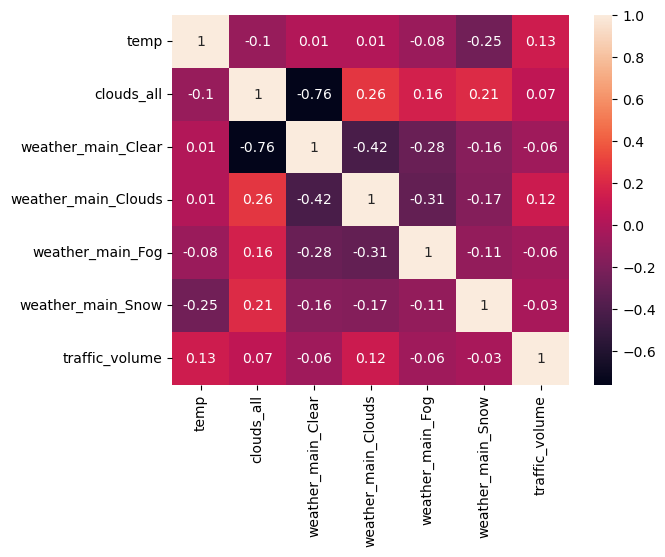

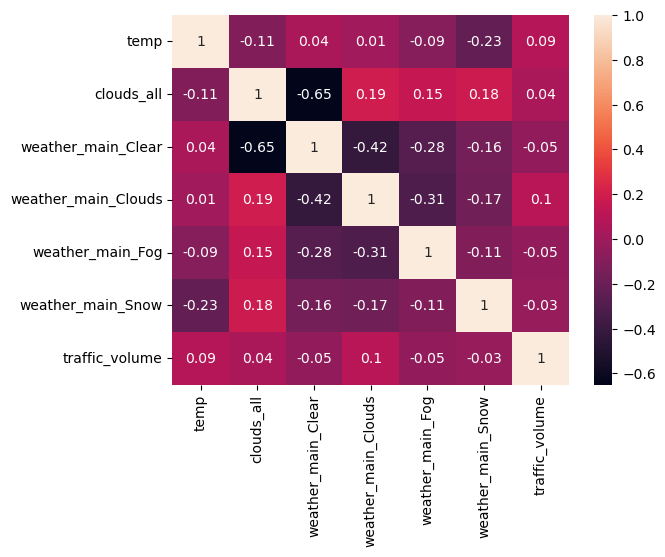

In [253]:
matrix = data_project1_filtered.corr(method='pearson').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

matrix = data_project1_filtered.corr(method='kendall').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

#### Train/Test podela filter skupa na osnovu na osnovu raspodele podataka

In [284]:
labels = np.array(data_project1_filtered_by_dist['traffic_volume'])
features= data_project1_filtered_by_dist.drop('traffic_volume', axis = 1)

#saving names for later use
feature_list = list(features.columns)

# Convert to numpy array
features = np.array(features)

# Split the data into training and testing sets
train_features_filtered_by_dist, test_features_filtered_by_dist, train_labels_filtered_by_dist, test_labels_filtered_by_dist = train_test_split(features, labels, test_size = 0.25, random_state = 42)

print('Training Features Shape:', train_features_filtered_by_dist.shape)
print('Training Labels Shape:', train_labels_filtered_by_dist.shape)
print('Testing Features Shape:', test_features_filtered_by_dist.shape)
print('Testing Labels Shape:', test_labels_filtered_by_dist.shape)


Training Features Shape: (35087, 7)
Training Labels Shape: (35087,)
Testing Features Shape: (11696, 7)
Testing Labels Shape: (11696,)


#### Train/Test podela filter skupa na osnovu matrice korelacije

In [254]:
labels = np.array(data_project1_filtered['traffic_volume'])
features= data_project1_filtered.drop('traffic_volume', axis = 1)

#saving names for later use
feature_list = list(features.columns)

# Convert to numpy array
features = np.array(features)

# Split the data into training and testing sets
train_features_filtered, test_features_filtered, train_labels_filtered, test_labels_filtered = train_test_split(features, labels, test_size = 0.25, random_state = 42)

print('Training Features Shape:', train_features_filtered.shape)
print('Training Labels Shape:', train_labels_filtered.shape)
print('Testing Features Shape:', test_features_filtered.shape)
print('Testing Labels Shape:', test_labels_filtered.shape)


Training Features Shape: (36153, 6)
Training Labels Shape: (36153,)
Testing Features Shape: (12051, 6)
Testing Labels Shape: (12051,)


#### Train/Test podela osnovnog skupa

In [255]:
labels = np.array(data_project1['traffic_volume'])
features= data_project1.drop('traffic_volume', axis = 1)

#saving names for later use
feature_list = list(features.columns)

# Convert to numpy array
features = np.array(features)

# Split the data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 42)

print('Training Features Shape:', train_features.shape)
print('Training Labels Shape:', train_labels.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)

Training Features Shape: (36153, 12)
Training Labels Shape: (36153,)
Testing Features Shape: (12051, 12)
Testing Labels Shape: (12051,)


#### Pomoćna funkcija za primenu različitih modela nad train i test skupovima podataka radi evaluacije

In [256]:
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error

def train_test_various_models(models, X_train, X_test, y_train, y_test):
    """trains and test given models on given data"""
    data_table=pd.DataFrame(columns=['model','r2_score training', 'r2_score test', 'MSE training', 'MSE test'])
    for model_name, model in models.items():
        model.fit(X_train, y_train)
        y_train_pred = model.predict(X_train)
        y_test_pred = model.predict(X_test)
        num_rows = data_table.shape[0]
        data_table.loc[num_rows+1] = [model_name, r2_score(y_train, y_train_pred),
         r2_score(y_test, y_test_pred),
          np.sqrt(mean_squared_error(y_train, y_train_pred)),
           np.sqrt(mean_squared_error(y_test, y_test_pred))]

    return data_table

#### Modeli za evaluaciju

In [257]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor      
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import ElasticNet

models = {
    'best_linear_regression_hyperparameters': LinearRegression(),
    'best random_forest_regressor_hyperparameters': RandomForestRegressor(max_depth=17, n_estimators=100, min_samples_leaf=10),
    'best decision_tree_regresor_hyperparameters': DecisionTreeRegressor(max_depth=15, min_samples_leaf=50),
    'default gradient_boost': GradientBoostingRegressor(),
    'gradient_boost_with_parameters': GradientBoostingRegressor(n_estimators=600, max_depth=5, learning_rate=0.01, min_samples_split=3),
    'elastic_net': ElasticNet(alpha=1.0, l1_ratio=0.5)

}

### Rezultati nad celokupnim skupom podataka

In [258]:

results = train_test_various_models(models, train_features, test_features, train_labels, test_labels)
results.head()

,model,r2_score training,r2_score test,MSE training,MSE test
1,best_linear_regression_hyperparameters,0.036277,0.037868,1949.874442,1950.640162
2,best random_forest_regressor_hyperparameters,0.212000,0.102549,1763.167565,1883.932051
3,best decision_tree_regresor_hyperparameters,0.123180,0.070387,1859.883621,1917.391543
4,default gradient_boost,0.086236,0.081011,1898.661414,1906.403844
5,gradient_boost_with_parameters,0.101836,0.089558,1882.383826,1897.518102


### Rezultati nad filtriranim skupom podataka (na osnovu matrice korelacije)

In [259]:
results_filtered = train_test_various_models(models, train_features_filtered, test_features_filtered, train_labels_filtered, test_labels_filtered)
results_filtered.head()

,model,r2_score training,r2_score test,MSE training,MSE test
1,best_linear_regression_hyperparameters,0.034807,0.037643,1951.360901,1950.867914
2,best random_forest_regressor_hyperparameters,0.209621,0.096643,1765.826392,1890.120934
3,best decision_tree_regresor_hyperparameters,0.125349,0.071964,1857.580951,1915.765377
4,default gradient_boost,0.083947,0.079965,1901.037701,1907.489072
5,gradient_boost_with_parameters,0.100271,0.086881,1884.023945,1900.305821


### Rezultati nad filtriranim skupom podataka (na osnovu raspodele podataka)

In [285]:
results_filtered_by_dist = train_test_various_models(models, train_features_filtered_by_dist, test_features_filtered_by_dist, train_labels_filtered_by_dist, test_labels_filtered_by_dist)
results_filtered_by_dist.head()

,model,r2_score training,r2_score test,MSE training,MSE test
1,best_linear_regression_hyperparameters,0.038844,0.035931,1947.094077,1952.252765
2,best random_forest_regressor_hyperparameters,0.219267,0.090266,1754.855666,1896.440438
3,best decision_tree_regresor_hyperparameters,0.129290,0.062612,1853.219603,1925.048512
4,default gradient_boost,0.090788,0.074131,1893.750331,1913.183700
5,gradient_boost_with_parameters,0.108431,0.080750,1875.286425,1906.333018


#### U razlici rezultata važi:
  1) Ako je MSE negativno, pogoršali smo rezultate
  2) Ako je MSE pozitivno, poboljšali smo rezultate

### Razlika u rezultatu između celokupnog skupa i filtriranog skupa (na osnovu matrice korelacije)

In [195]:
result_difference = results.loc[:, results.columns != 'model'] - results_filtered.loc[:, results_filtered.columns != 'model']
result_difference['model'] = results['model']
result_difference.head()

,r2_score training,r2_score test,MSE training,MSE test,model
1,0.001470,0.000225,-1.486460,-0.227752,best_linear_regression_hyperparameters
2,0.001022,0.005040,-1.142788,-5.279264,best random_forest_regressor_hyperparameters
3,-0.002170,-0.001520,2.302670,1.567942,best decision_tree_regresor_hyperparameters
4,0.002289,0.001045,-2.376287,-1.083870,default gradient_boost
5,0.001566,0.002686,-1.640119,-2.797478,gradient_boost_with_parameters


### Razlika u rezultatu između celokupnog skupa i filtriranog skupa (na osnovu raspodele podataka)

In [286]:
result_difference2 = results.loc[:, results.columns != 'model'] - results_filtered_by_dist.loc[:, results_filtered.columns != 'model']
result_difference2['model'] = results['model']
result_difference2.head()

,r2_score training,r2_score test,MSE training,MSE test,model
1,-0.002568,0.001937,2.780364,-1.612603,best_linear_regression_hyperparameters
2,-0.007267,0.012283,8.311900,-12.508386,best random_forest_regressor_hyperparameters
3,-0.006110,0.007776,6.664018,-7.656969,best decision_tree_regresor_hyperparameters
4,-0.004552,0.006880,4.911083,-6.779856,default gradient_boost
5,-0.006594,0.008808,7.097401,-8.814916,gradient_boost_with_parameters


### ML PROJECT 2 

In [51]:
data_project2 = pd.read_csv("data/ML_Project2 - responses.csv")

In [52]:
data_project2.head()

,Music,Slow songs or fast songs,Dance,Folk,Country,Classical music,Musical,Pop,Rock,Metal or Hardrock,...,Age,Height,Weight,Number of siblings,Gender,Left - right handed,Education,Only child,Village - town,House - block of flats
0,5.0,3.0,2.0,1.0,2.0,2.0,1.0,5.0,5.0,1.0,...,20.0,163.0,48.0,1.0,female,right handed,college/bachelor degree,no,village,block of flats
1,4.0,4.0,2.0,1.0,1.0,1.0,2.0,3.0,5.0,4.0,...,19.0,163.0,58.0,2.0,female,right handed,college/bachelor degree,no,city,block of flats
2,5.0,5.0,2.0,2.0,3.0,4.0,5.0,3.0,5.0,3.0,...,20.0,176.0,67.0,2.0,female,right handed,secondary school,no,city,block of flats
3,5.0,3.0,2.0,1.0,1.0,1.0,1.0,2.0,2.0,1.0,...,22.0,172.0,59.0,1.0,female,right handed,college/bachelor degree,yes,city,house/bungalow
4,5.0,3.0,4.0,3.0,2.0,4.0,3.0,5.0,3.0,1.0,...,20.0,170.0,59.0,1.0,female,right handed,secondary school,no,village,house/bungalow


In [53]:
data_project2._get_numeric_data().columns

Index(['Music', 'Slow songs or fast songs', 'Dance', 'Folk', 'Country',
       'Classical music', 'Musical', 'Pop', 'Rock', 'Metal or Hardrock',
       ...
       'Shopping centres', 'Branded clothing', 'Entertainment spending',
       'Spending on looks', 'Spending on gadgets',
       'Spending on healthy eating', 'Age', 'Height', 'Weight',
       'Number of siblings'],
      dtype='object', length=139)

In [54]:
data_project2_object = data_project2.select_dtypes(include='object')
#print(data_project2_object.columns)

print("Broj unique vrednosti svakog kategoričkog atributa")
print(data_project2[data_project2_object.columns].nunique())

Broj unique vrednosti svakog kategoričkog atributa
Smoking                   4
Alcohol                   3
Punctuality               3
Lying                     4
Internet usage            4
Gender                    2
Left - right handed       2
Education                 6
Only child                2
Village - town            2
House - block of flats    2
dtype: int64


## Korišćenjem pandas, seaborn i matplotlib metoda

In [55]:
data_project2.describe()

,Music,Slow songs or fast songs,Dance,Folk,Country,Classical music,Musical,Pop,Rock,Metal or Hardrock,...,Shopping centres,Branded clothing,Entertainment spending,Spending on looks,Spending on gadgets,Spending on healthy eating,Age,Height,Weight,Number of siblings
count,1007.000000,1008.000000,1006.000000,1005.000000,1005.000000,1003.000000,1008.000000,1007.000000,1004.000000,1007.000000,...,1008.000000,1008.000000,1007.000000,1007.000000,1010.000000,1008.00000,1003.000000,990.000000,990.000000,1004.000000
mean,4.731877,3.328373,3.113320,2.288557,2.123383,2.956132,2.761905,3.471698,3.761952,2.361470,...,3.234127,3.050595,3.201589,3.106256,2.870297,3.55754,20.433699,173.514141,66.405051,1.297809
std,0.664049,0.833931,1.170568,1.138916,1.076136,1.252570,1.260845,1.161400,1.184861,1.372995,...,1.323062,1.306321,1.188947,1.205368,1.284970,1.09375,2.828840,10.024505,13.839561,1.013348
min,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,15.000000,62.000000,41.000000,0.000000
25%,5.000000,3.000000,2.000000,1.000000,1.000000,2.000000,2.000000,3.000000,3.000000,1.000000,...,2.000000,2.000000,2.000000,2.000000,2.000000,3.00000,19.000000,167.000000,55.000000,1.000000
50%,5.000000,3.000000,3.000000,2.000000,2.000000,3.000000,3.000000,4.000000,4.000000,2.000000,...,3.000000,3.000000,3.000000,3.000000,3.000000,4.00000,20.000000,173.000000,64.000000,1.000000
75%,5.000000,4.000000,4.000000,3.000000,3.000000,4.000000,4.000000,4.000000,5.000000,3.000000,...,4.000000,4.000000,4.000000,4.000000,4.000000,4.00000,22.000000,180.000000,75.000000,2.000000
max,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,...,5.000000,5.000000,5.000000,5.000000,5.000000,5.00000,30.000000,203.000000,165.000000,10.000000


### Mere centralne tendencije

In [56]:
data_project2.mean(numeric_only=True)

Music                           4.731877
Slow songs or fast songs        3.328373
Dance                           3.113320
Folk                            2.288557
Country                         2.123383
                                 ...    
Spending on healthy eating      3.557540
Age                            20.433699
Height                        173.514141
Weight                         66.405051
Number of siblings              1.297809
Length: 139, dtype: float64

In [57]:
data_project2.median(numeric_only=True)

Music                           5.0
Slow songs or fast songs        3.0
Dance                           3.0
Folk                            2.0
Country                         2.0
                              ...  
Spending on healthy eating      4.0
Age                            20.0
Height                        173.0
Weight                         64.0
Number of siblings              1.0
Length: 139, dtype: float64

In [58]:
data_project2.mode(axis=0).head(1)

,Music,Slow songs or fast songs,Dance,Folk,Country,Classical music,Musical,Pop,Rock,Metal or Hardrock,...,Age,Height,Weight,Number of siblings,Gender,Left - right handed,Education,Only child,Village - town,House - block of flats
0,5.0,3.0,3.0,2.0,2.0,3.0,3.0,4.0,5.0,1.0,...,19.0,170.0,60.0,1.0,female,right handed,secondary school,no,city,block of flats


## Raspodela podataka

#### Age atribut

<AxesSubplot:xlabel='Age', ylabel='Count'>

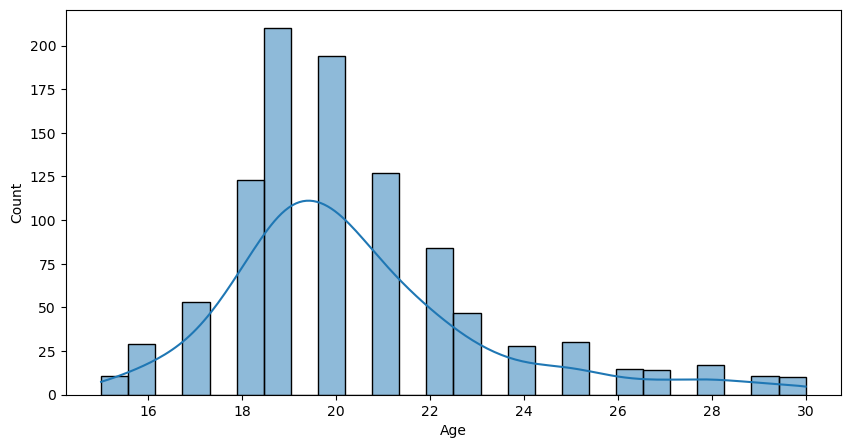

In [59]:
plt.figure(figsize=(10,5))
sns.histplot(data_project2['Age'], kde=True)

<AxesSubplot:xlabel='Age'>

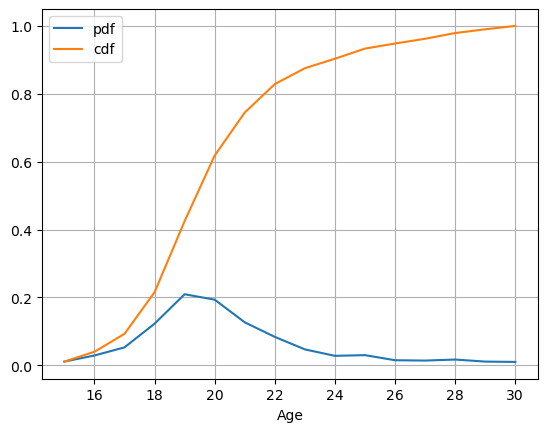

In [60]:
stats_df = data_project2 \
.groupby('Age') \
['Age'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'Age': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "Age",  y = ['pdf', 'cdf'], grid = True)

#### Height atribut

<AxesSubplot:xlabel='Height', ylabel='Count'>

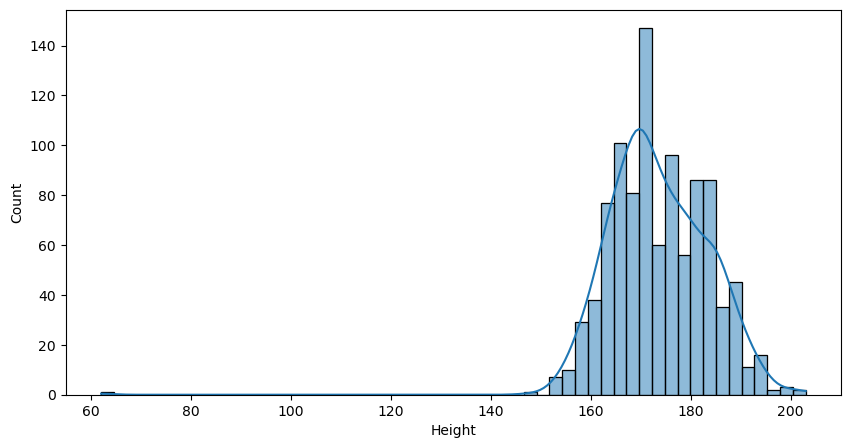

In [61]:
plt.figure(figsize=(10,5))
sns.histplot(data_project2['Height'], kde=True)

<AxesSubplot:xlabel='Height'>

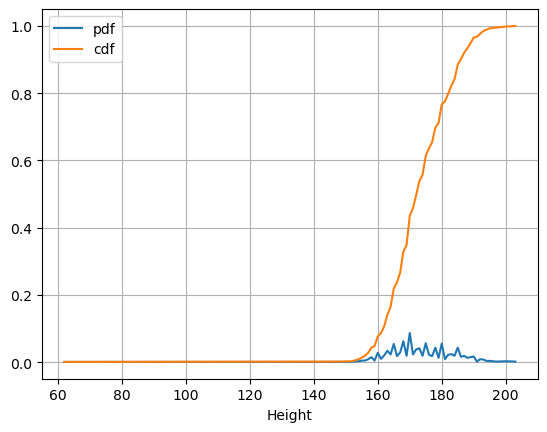

In [62]:
stats_df = data_project2 \
.groupby('Height') \
['Height'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'Height': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "Height",  y = ['pdf', 'cdf'], grid = True)

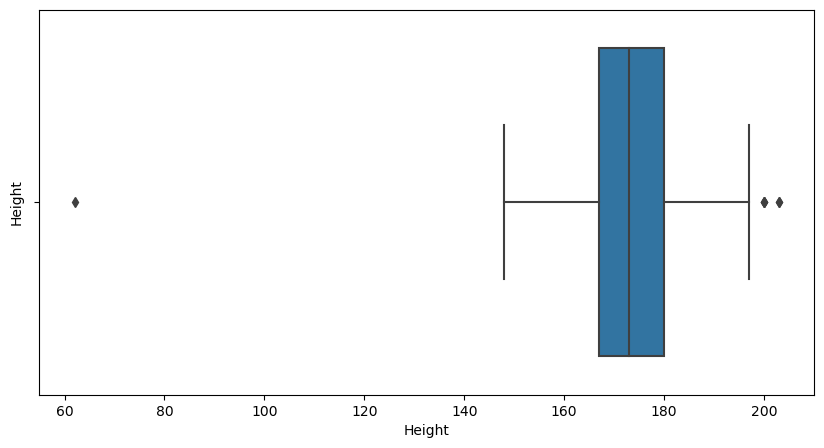

In [63]:
plt.figure(figsize=(10,5))
#plt.xlim(0,1000)
plt.ylabel('Height')
sns.boxplot(x=data_project2['Height'])
plt.show()

#### Weight atribut

<AxesSubplot:xlabel='Weight', ylabel='Count'>

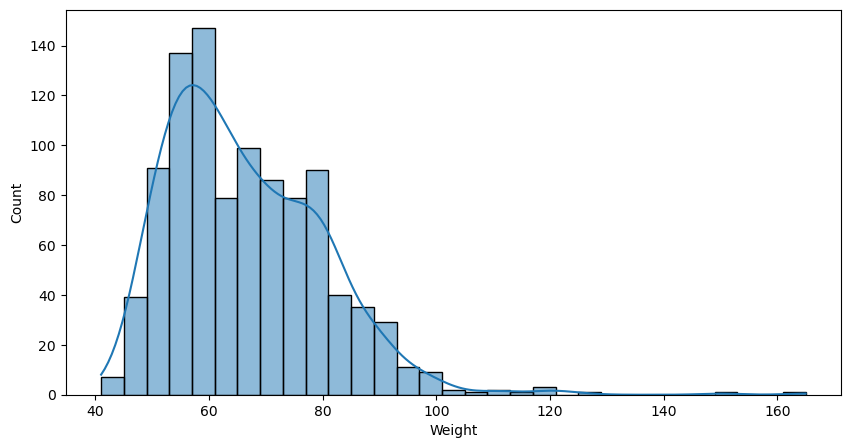

In [64]:
plt.figure(figsize=(10,5))
sns.histplot(data_project2['Weight'], kde=True)

<AxesSubplot:xlabel='Weight'>

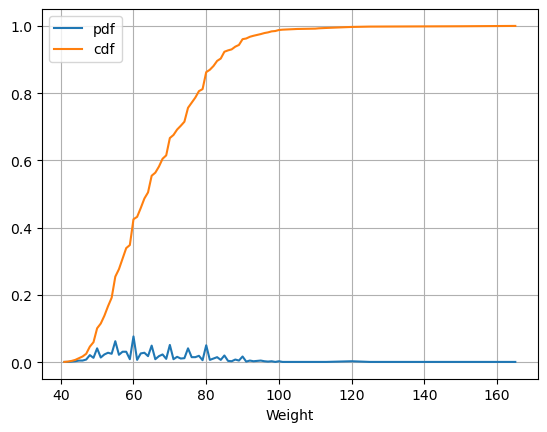

In [65]:
stats_df = data_project2 \
.groupby('Weight') \
['Weight'] \
.agg('count') \
.pipe(pd.DataFrame) \
.rename(columns = {'Weight': 'frequency'})

# PDF
stats_df['pdf'] = stats_df['frequency'] / sum(stats_df['frequency'])

# CDF
stats_df['cdf'] = stats_df['pdf'].cumsum()
stats_df = stats_df.reset_index()


stats_df.plot(x = "Weight",  y = ['pdf', 'cdf'], grid = True)

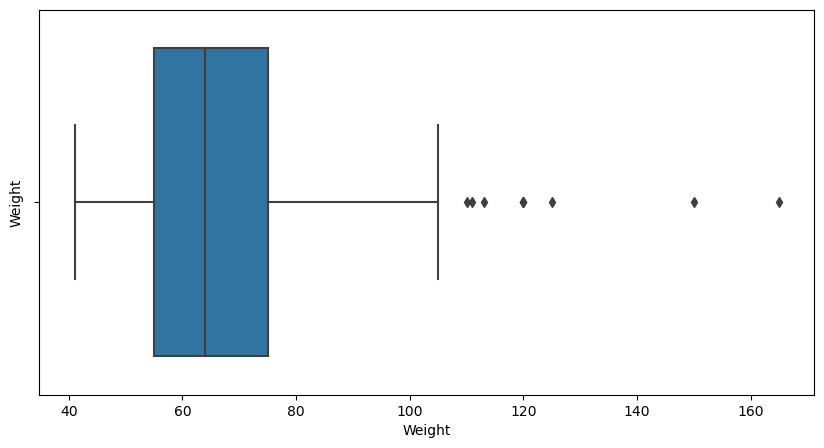

In [66]:
plt.figure(figsize=(10,5))
#plt.xlim(0,1000)
plt.ylabel('Weight')
sns.boxplot(x=data_project2['Weight'])
plt.show()

#### Kategorički podaci

<AxesSubplot:xlabel='Gender', ylabel='count'>

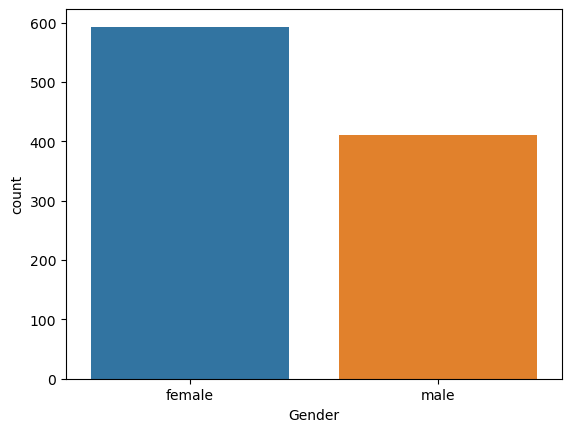

In [67]:
sns.countplot(x='Gender', data=data_project2)

<AxesSubplot:xlabel='Smoking', ylabel='count'>

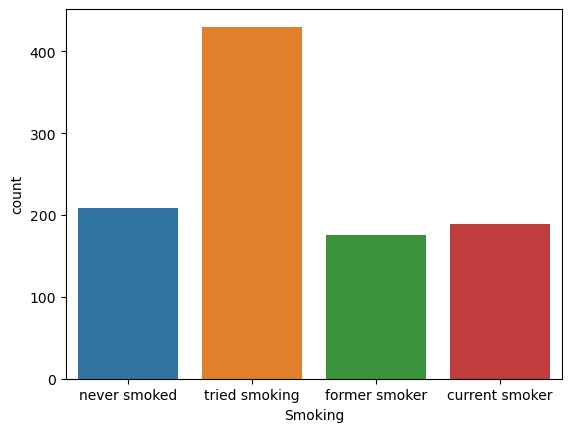

In [68]:
sns.countplot(x='Smoking', data=data_project2)

<AxesSubplot:xlabel='count', ylabel='Education'>

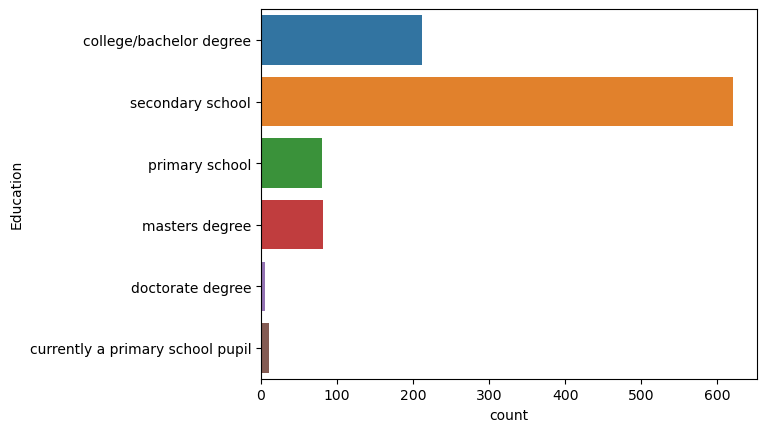

In [69]:
sns.countplot(y='Education', data=data_project2)

([0, 1, 2, 3, 4, 5],
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

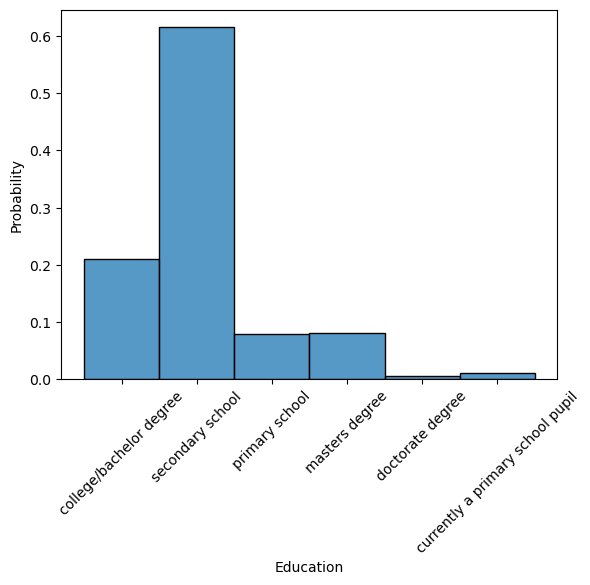

In [70]:
sns.histplot(data_project2['Education'], stat='probability')
plt.xticks(rotation=45)

([0, 1, 2, 3],
 [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])

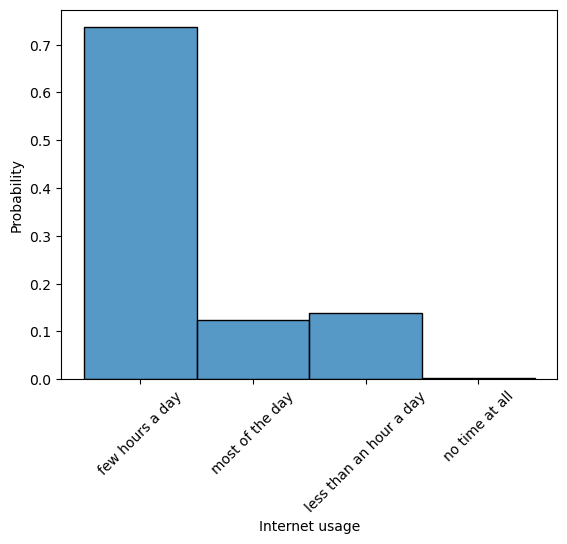

In [71]:
sns.histplot(data_project2['Internet usage'], stat='probability')
plt.xticks(rotation=45)

([0, 1, 2], [Text(0, 0, ''), Text(0, 0, ''), Text(0, 0, '')])

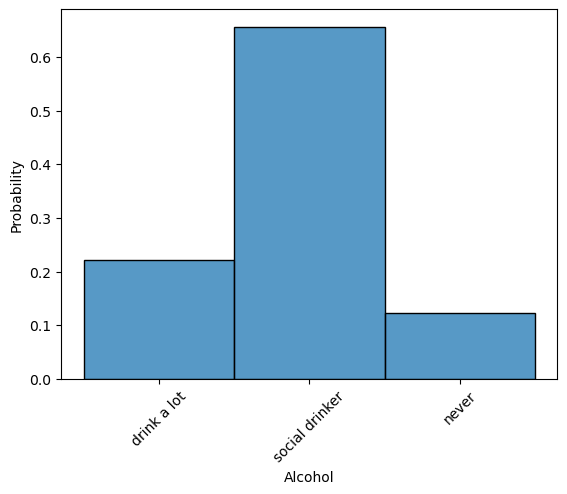

In [72]:
sns.histplot(data_project2['Alcohol'], stat='probability')
plt.xticks(rotation=45)

## Matrica korelacije

C:\Users\Legion\AppData\Local\Temp\ipykernel_7016\728409174.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  PersonalityDF.replace(['currently a primary school pupil', 'primary school', 'secondary school', 'college/bachelor degree', 'masters degree', 'doctorate degree'], [0, 1, 2, 3, 4, 5], inplace=True)


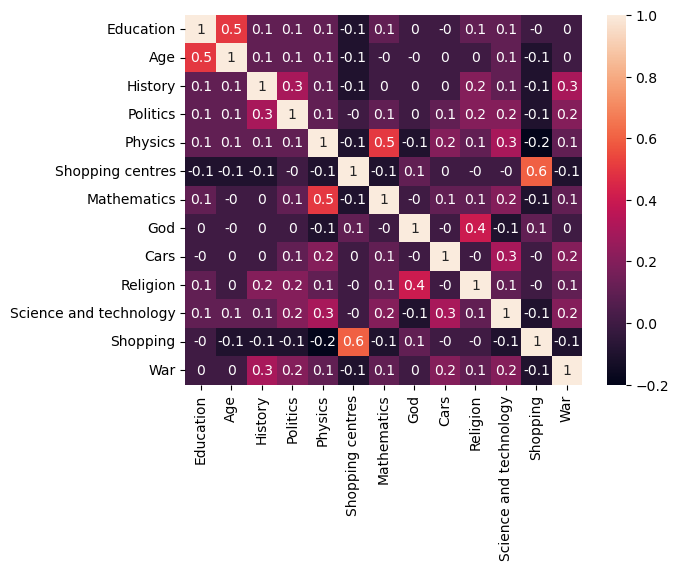

In [73]:

PersonalityDF = data_project2[['Gender', 'Education', 'Age', 'History', 'Politics', 'Physics', 'Shopping centres', 'Mathematics', 'God', 'Cars', 'Religion', 'Science and technology', 'Shopping', 'War']]
PersonalityDF.replace(['currently a primary school pupil', 'primary school', 'secondary school', 'college/bachelor degree', 'masters degree', 'doctorate degree'], [0, 1, 2, 3, 4, 5], inplace=True)

matrix = PersonalityDF._get_numeric_data().corr(method='kendall', min_periods=1).round(1)
#matrix = PersonalityDF.apply(lambda x : pd.factorize(x)[0]).corr(method='kendall', min_periods=1).round(1)

sns.heatmap(matrix, annot=True)
plt.show()

## Varijansa i standardna devijacija

In [74]:
data_project2.var(numeric_only=True).round(2).sort_values()

Personality           0.41
Music                 0.44
Dreams                0.47
Movies                0.48
Fun with friends      0.54
                     ...  
Pets                  2.39
Elections             2.48
Age                   8.00
Height              100.49
Weight              191.53
Length: 139, dtype: float64

In [75]:
data_project2.std(numeric_only=True).round(2).sort_values()

Personality          0.64
Music                0.66
Dreams               0.68
Movies               0.69
Fun with friends     0.74
                    ...  
Pets                 1.55
Elections            1.57
Age                  2.83
Height              10.02
Weight              13.84
Length: 139, dtype: float64

#### EDA analiza Projekta 2

In [76]:
project2_report = ProfileReport(data_project2)

In [77]:
project2_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### ML PROJECT 3

In [78]:
data_project3 = pd.read_csv("data/ML_Project3 - Churn_Modelling.csv")

In [79]:
data_project3.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


## Korišćenjem pandas, seaborn i matplotlib metoda

In [80]:
data_project3.describe()

,RowNumber,CustomerId,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
count,10000.00000,1.000000e+04,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000
mean,5000.50000,1.569094e+07,650.528800,38.921800,5.012800,76485.889288,1.530200,0.70550,0.515100,100090.239881,0.203700
std,2886.89568,7.193619e+04,96.653299,10.487806,2.892174,62397.405202,0.581654,0.45584,0.499797,57510.492818,0.402769
min,1.00000,1.556570e+07,350.000000,18.000000,0.000000,0.000000,1.000000,0.00000,0.000000,11.580000,0.000000
25%,2500.75000,1.562853e+07,584.000000,32.000000,3.000000,0.000000,1.000000,0.00000,0.000000,51002.110000,0.000000
50%,5000.50000,1.569074e+07,652.000000,37.000000,5.000000,97198.540000,1.000000,1.00000,1.000000,100193.915000,0.000000
75%,7500.25000,1.575323e+07,718.000000,44.000000,7.000000,127644.240000,2.000000,1.00000,1.000000,149388.247500,0.000000
max,10000.00000,1.581569e+07,850.000000,92.000000,10.000000,250898.090000,4.000000,1.00000,1.000000,199992.480000,1.000000


### Mere centralne tendencije

In [81]:
data_project3.mean(numeric_only=True).round(2)

RowNumber              5000.50
CustomerId         15690940.57
CreditScore             650.53
Age                      38.92
Tenure                    5.01
Balance               76485.89
NumOfProducts             1.53
HasCrCard                 0.71
IsActiveMember            0.52
EstimatedSalary      100090.24
Exited                    0.20
dtype: float64

In [82]:
data_project3.median(numeric_only=True).round(2)

RowNumber              5000.50
CustomerId         15690738.00
CreditScore             652.00
Age                      37.00
Tenure                    5.00
Balance               97198.54
NumOfProducts             1.00
HasCrCard                 1.00
IsActiveMember            1.00
EstimatedSalary      100193.92
Exited                    0.00
dtype: float64

In [83]:
data_project3.mode(axis=0).head(1)

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15565701,Smith,850.0,France,Male,37.0,2.0,0.0,1.0,1.0,1.0,24924.92,0.0


## Raspodela podataka

#### CreditScore atribut

<AxesSubplot:xlabel='CreditScore', ylabel='Count'>

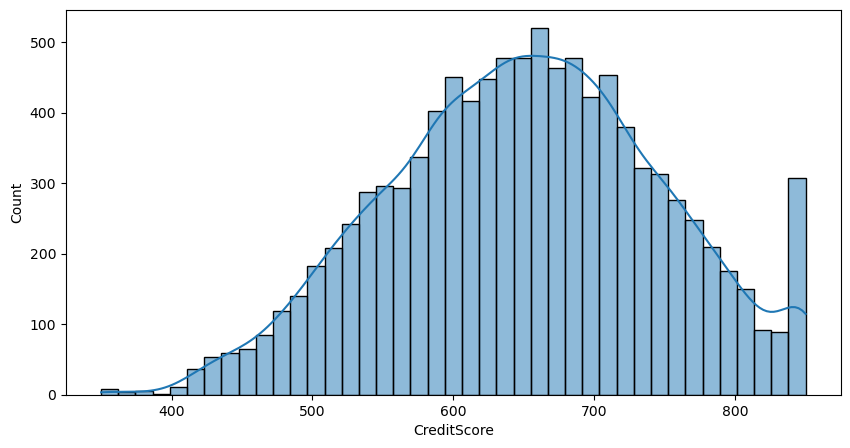

In [84]:
plt.figure(figsize=(10,5))
sns.histplot(data_project3['CreditScore'], kde=True)

<AxesSubplot:xlabel='CreditScore', ylabel='Density'>

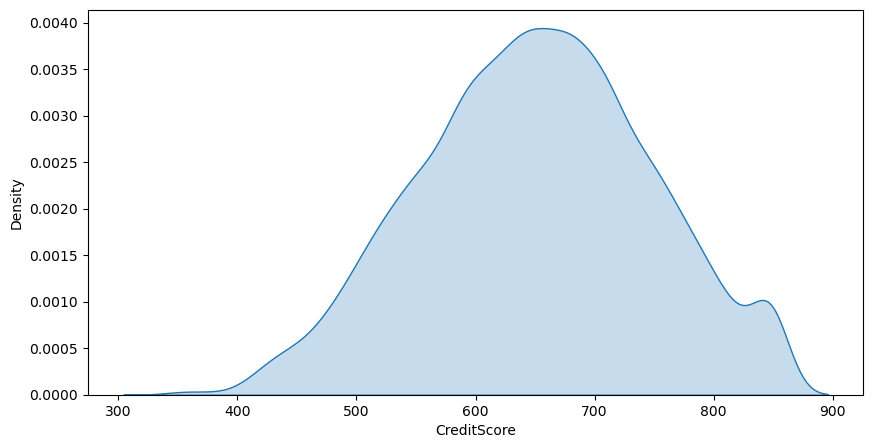

In [85]:
plt.figure(figsize=(10,5))
plt.xlabel('CreditScore')
plt.ylabel('Density')
sns.kdeplot(data_project3['CreditScore'],shade=True)

#### Age

<AxesSubplot:xlabel='Age', ylabel='Count'>

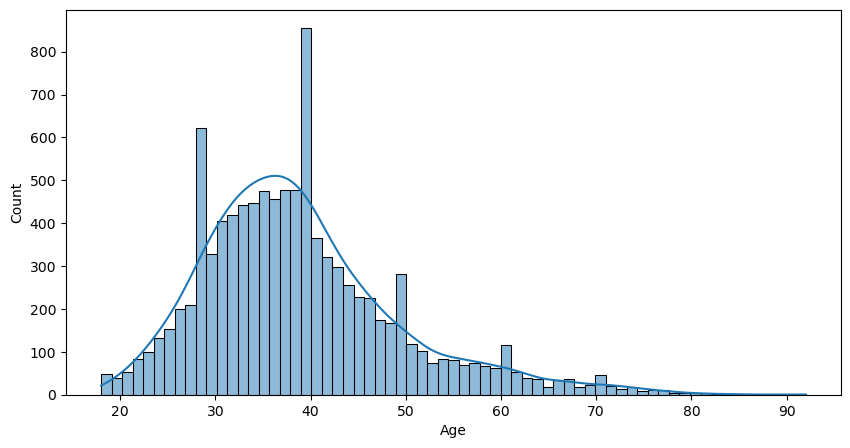

In [86]:
plt.figure(figsize=(10,5))
sns.histplot(data_project3['Age'], kde=True)

#### Tenure atribut

<AxesSubplot:xlabel='Tenure', ylabel='Count'>

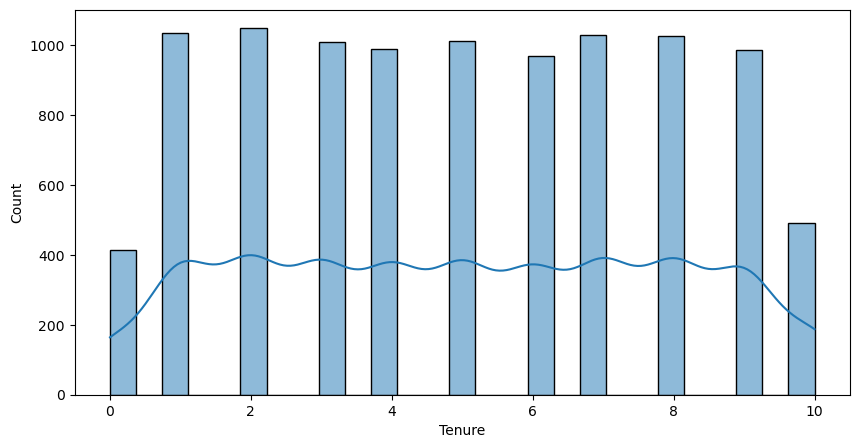

In [87]:
plt.figure(figsize=(10,5))
sns.histplot(data_project3['Tenure'], kde=True)

#### Balance atribut

<AxesSubplot:xlabel='Balance', ylabel='Count'>

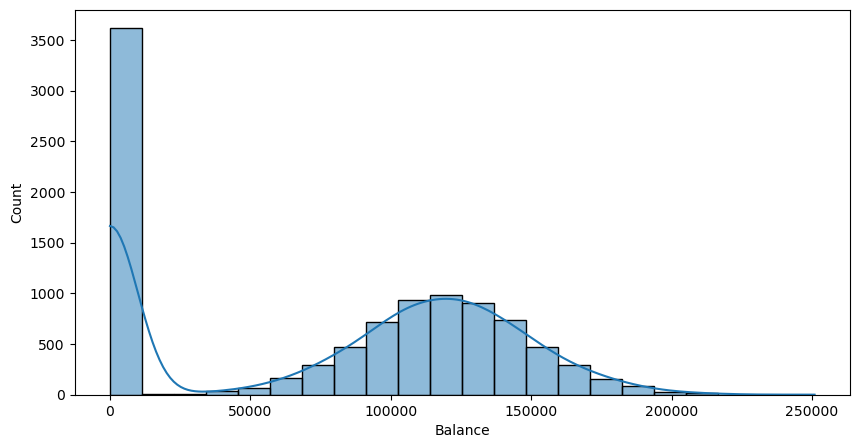

In [88]:
plt.figure(figsize=(10,5))
sns.histplot(data_project3['Balance'], kde=True)

#### Ukoliko izbacimo male vrednosti dobijamo gotovo idealni Gausovu raspodelu

<AxesSubplot:xlabel='Balance', ylabel='Count'>

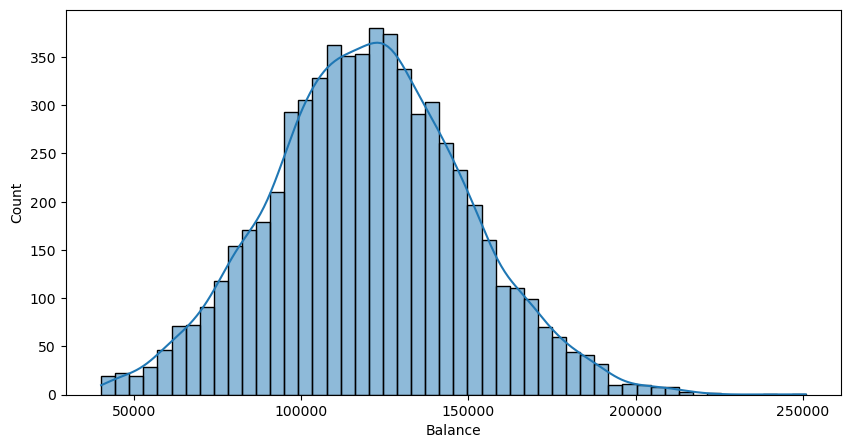

In [89]:
filtered_data_project3 = data_project3.loc[data_project3['Balance']> 40000]['Balance']

plt.figure(figsize=(10,5))
sns.histplot(filtered_data_project3, kde=True)

array([[<AxesSubplot:title={'center':'RowNumber'}>,
        <AxesSubplot:title={'center':'CustomerId'}>,
        <AxesSubplot:title={'center':'CreditScore'}>],
       [<AxesSubplot:title={'center':'Age'}>,
        <AxesSubplot:title={'center':'Tenure'}>,
        <AxesSubplot:title={'center':'Balance'}>],
       [<AxesSubplot:title={'center':'NumOfProducts'}>,
        <AxesSubplot:title={'center':'HasCrCard'}>,
        <AxesSubplot:title={'center':'IsActiveMember'}>],
       [<AxesSubplot:title={'center':'EstimatedSalary'}>,
        <AxesSubplot:title={'center':'Exited'}>, <AxesSubplot:>]],
      dtype=object)

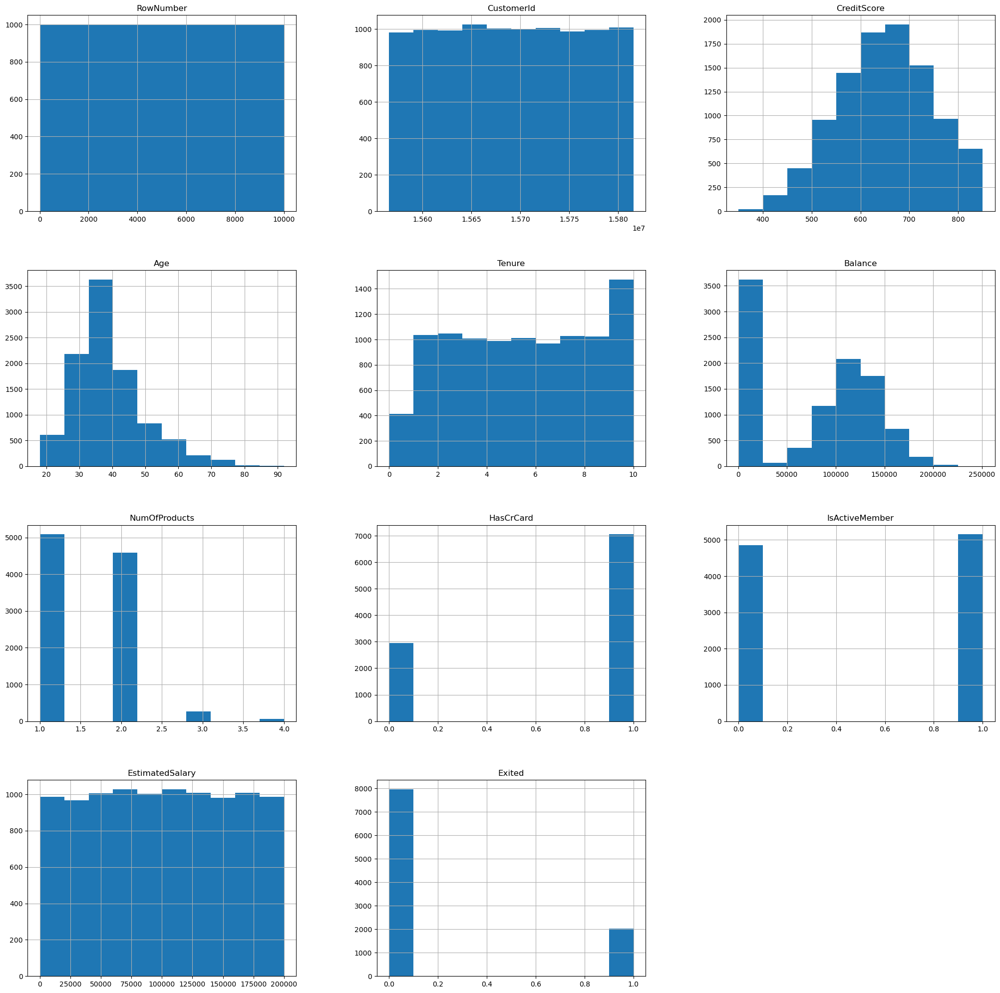

In [90]:
data_project3.hist(figsize = (25,25))


## Matrica korelacije

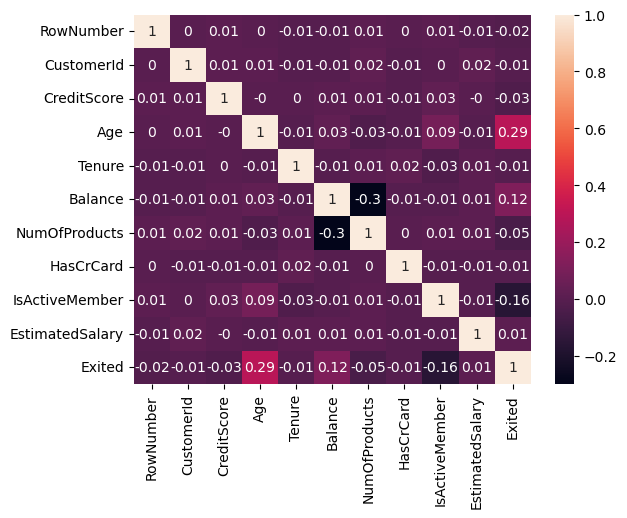

In [91]:
matrix = data_project3.corr().round(2)
sns.heatmap(matrix, annot=True)
plt.show()

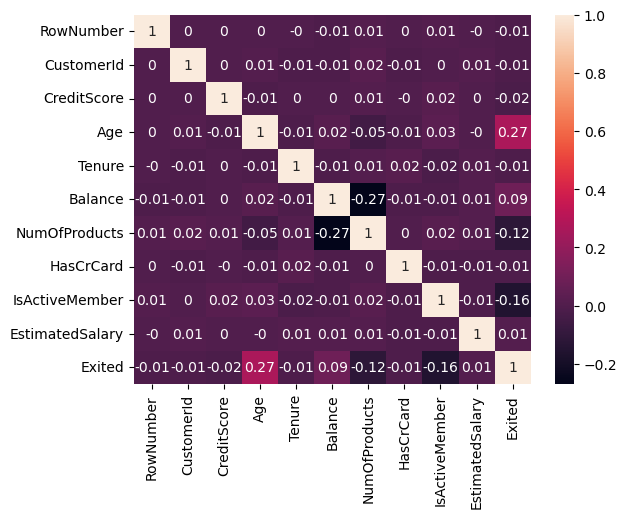

In [92]:
matrix = data_project3.corr(method='kendall').round(2)
sns.heatmap(matrix, annot=True)
plt.show()

## Varijansa i standardna devijacija

In [93]:
data_project3.var(numeric_only=True).astype('int64')

RowNumber             8334166
CustomerId         5174814873
CreditScore              9341
Age                       109
Tenure                      8
Balance            3893436175
NumOfProducts               0
HasCrCard                   0
IsActiveMember              0
EstimatedSalary    3307456784
Exited                      0
dtype: int64

In [94]:
float(data_project3.var(numeric_only=True)['RowNumber'])

8334166.666666667

In [95]:
data_project3.std(numeric_only=True).round(2)

RowNumber           2886.90
CustomerId         71936.19
CreditScore           96.65
Age                   10.49
Tenure                 2.89
Balance            62397.41
NumOfProducts          0.58
HasCrCard              0.46
IsActiveMember         0.50
EstimatedSalary    57510.49
Exited                 0.40
dtype: float64

#### EDA analiza Projekta 3

In [96]:
project3_report = ProfileReport(data_project3)

In [97]:
project3_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### UTICAJ RASPODELE PODATAKA I ZAVISNOSTI IZMEĐU PODATAKA NA REZULTATE ALGORITAMA MAŠINSKOG UČENJA

In [98]:
data_project3.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


#### One-Hot encoding kategoričkih atributa

In [99]:
def OneHotEncode(dataset):
    OH_encoder = OneHotEncoder(handle_unknown='ignore', sparse=False)

    columnsToEncode = ['Geography','Gender']
    OH_cols = pd.DataFrame(OH_encoder.fit_transform(dataset[columnsToEncode]))

    # One-hot encoding removed index; put it back
    OH_cols.index = dataset.index
    column_name = OH_encoder.get_feature_names_out(columnsToEncode)
    OH_cols.columns = column_name

    # Remove categorical columns (will replace with one-hot encoding)
    num_X = dataset.drop(columnsToEncode, axis=1)
    OH_X = pd.concat([num_X, OH_cols], axis=1)
    #one_hot_encoded_frame = pd.DataFrame.sparse.from_spmatrix(OH_X, columns= column_name)

    dataset=OH_X
    OH_cols = pd.DataFrame(dataset[['Exited']])
    num_X = dataset.drop("Exited", axis=1)
    Odf_X = pd.concat([num_X, OH_cols], axis=1)
    dataset=Odf_X.copy()
    return dataset

In [100]:
data_project3 = OneHotEncode(data_project3)
data_project3.head()

,RowNumber,CustomerId,Surname,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male,Exited
0,1,15634602,Hargrave,619,42,2,0.00,1,1,1,101348.88,1.0,0.0,0.0,1.0,0.0,1
1,2,15647311,Hill,608,41,1,83807.86,1,0,1,112542.58,0.0,0.0,1.0,1.0,0.0,0
2,3,15619304,Onio,502,42,8,159660.80,3,1,0,113931.57,1.0,0.0,0.0,1.0,0.0,1
3,4,15701354,Boni,699,39,1,0.00,2,0,0,93826.63,1.0,0.0,0.0,1.0,0.0,0
4,5,15737888,Mitchell,850,43,2,125510.82,1,1,1,79084.10,0.0,0.0,1.0,1.0,0.0,0


### Enkodiranje Surname atributa

In [101]:
label_encoder = preprocessing.LabelEncoder()

data_project3['Surname']= label_encoder.fit_transform(data_project3['Surname'])

### Matrica korelacije enkodiranih podataka

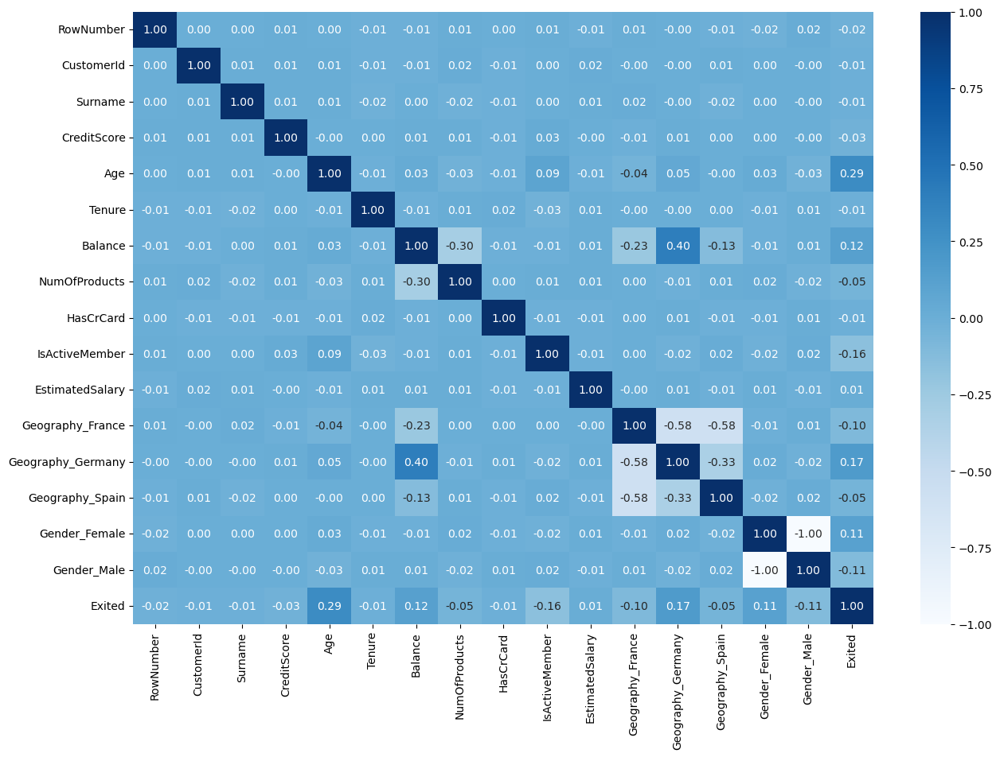

In [102]:
# matrix = data_project3.corr().round(2)
# sns.heatmap(matrix, annot=True)
# plt.show()

fig, ax = plt.subplots(figsize=(15,10))   
sns.heatmap(data_project3.corr().round(2), annot = True , fmt=".2f",ax=ax ,cmap = "Blues")
plt.show()

### Skaliranje podataka

In [103]:
def ScaleColumns(dataset):
    columnsForScaling = ["CreditScore", "Age", "Tenure", "Balance", "EstimatedSalary"]
    for columnForScaling in columnsForScaling:
        dataset[columnForScaling] = (dataset[columnForScaling] - np.min(dataset[columnForScaling])) / \
            (np.max(dataset[columnForScaling])-np.min(dataset[columnForScaling]))
    return dataset

In [104]:
data_project3_Scaled = ScaleColumns(data_project3)
data_project3_Scaled.head()

,RowNumber,CustomerId,Surname,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male,Exited
0,1,15634602,1115,0.538,0.324324,0.2,0.000000,1,1,1,0.506735,1.0,0.0,0.0,1.0,0.0,1
1,2,15647311,1177,0.516,0.310811,0.1,0.334031,1,0,1,0.562709,0.0,0.0,1.0,1.0,0.0,0
2,3,15619304,2040,0.304,0.324324,0.8,0.636357,3,1,0,0.569654,1.0,0.0,0.0,1.0,0.0,1
3,4,15701354,289,0.698,0.283784,0.1,0.000000,2,0,0,0.469120,1.0,0.0,0.0,1.0,0.0,0
4,5,15737888,1822,1.000,0.337838,0.2,0.500246,1,1,1,0.395400,0.0,0.0,1.0,1.0,0.0,0


### Balansiranje skupa podataka

In [105]:
less = len(data_project3_Scaled[data_project3_Scaled['Exited'] == 1])
more = len(data_project3_Scaled[data_project3_Scaled['Exited'] == 0])
class_distribution_ration = less/more
x = data_project3_Scaled.drop(["Exited"], axis = 1)
y = data_project3_Scaled["Exited"]

#Transformacija dataset-a
# oversampling
oversample = SMOTE()
X, Y = oversample.fit_resample(x, y)

frames = [X, Y]
data_project3_finished = pd.concat(frames, axis=1, join='inner')



In [106]:
data_project3_finished.head()

,RowNumber,CustomerId,Surname,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male,Exited
0,1,15634602,1115,0.538,0.324324,0.2,0.000000,1,1,1,0.506735,1.0,0.0,0.0,1.0,0.0,1
1,2,15647311,1177,0.516,0.310811,0.1,0.334031,1,0,1,0.562709,0.0,0.0,1.0,1.0,0.0,0
2,3,15619304,2040,0.304,0.324324,0.8,0.636357,3,1,0,0.569654,1.0,0.0,0.0,1.0,0.0,1
3,4,15701354,289,0.698,0.283784,0.1,0.000000,2,0,0,0.469120,1.0,0.0,0.0,1.0,0.0,0
4,5,15737888,1822,1.000,0.337838,0.2,0.500246,1,1,1,0.395400,0.0,0.0,1.0,1.0,0.0,0


### Kreiranje filtiriranog skupa podataka

In [107]:
data_project3_filtered = data_project3_finished.copy()
data_project3_filtered.head()

,RowNumber,CustomerId,Surname,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male,Exited
0,1,15634602,1115,0.538,0.324324,0.2,0.000000,1,1,1,0.506735,1.0,0.0,0.0,1.0,0.0,1
1,2,15647311,1177,0.516,0.310811,0.1,0.334031,1,0,1,0.562709,0.0,0.0,1.0,1.0,0.0,0
2,3,15619304,2040,0.304,0.324324,0.8,0.636357,3,1,0,0.569654,1.0,0.0,0.0,1.0,0.0,1
3,4,15701354,289,0.698,0.283784,0.1,0.000000,2,0,0,0.469120,1.0,0.0,0.0,1.0,0.0,0
4,5,15737888,1822,1.000,0.337838,0.2,0.500246,1,1,1,0.395400,0.0,0.0,1.0,1.0,0.0,0


#### Na osnovu matrice korelacije možemo izbaciti sledeće atribute

In [108]:
data_project3_filtered.drop(["RowNumber","CustomerId","Surname", "Tenure", "HasCrCard", "EstimatedSalary", "Age"], axis=1, inplace = True)

In [109]:
data_project3_filtered.head()

,CreditScore,Balance,NumOfProducts,IsActiveMember,Geography_France,Geography_Germany,Geography_Spain,Gender_Female,Gender_Male,Exited
0,0.538,0.000000,1,1,1.0,0.0,0.0,1.0,0.0,1
1,0.516,0.334031,1,1,0.0,0.0,1.0,1.0,0.0,0
2,0.304,0.636357,3,0,1.0,0.0,0.0,1.0,0.0,1
3,0.698,0.000000,2,0,1.0,0.0,0.0,1.0,0.0,0
4,1.000,0.500246,1,1,0.0,0.0,1.0,1.0,0.0,0


### Podela na Train/Test skupove podataka

In [110]:
X_finished = data_project3_finished.drop("Exited", axis=1).values
y_finished = data_project3_finished["Exited"].values

X_train_finished , X_test_finished, y_train_finished, y_test_finished = train_test_split(X_finished, y_finished, test_size = 0.2, random_state = 1)


In [111]:
print(X_train_finished.shape)
print(X_test_finished.shape)
print(y_train_finished.shape)
print(y_test_finished.shape)

(12740, 16)
(3186, 16)
(12740,)
(3186,)


In [112]:
X_filtered = data_project3_filtered.drop("Exited", axis=1).values
y_filtered = data_project3_filtered["Exited"].values

X_train_filtered ,X_test_filtered, y_train_filtered, y_test_filtered = train_test_split(X_filtered, y_filtered, test_size = 0.2, random_state = 1)


### Funkcija za procenu uspešnosti

In [151]:

def eval_model(y_true_, y_pred_):
    accuracy = accuracy_score(y_true_, y_pred_)
    f1 = f1_score(y_true_, y_pred_)
    precision = precision_score(y_true_, y_pred_)
    recall = recall_score(y_true_, y_pred_)
    conf_matrix = confusion_matrix(y_true=y_true_, y_pred=y_pred_)
    TN, FP, FN, TP = conf_matrix.ravel()
    sensitivity = TP / (TP + FN)
    specificity = TN / (TN + FP)

    print("Accuracy : ", accuracy)
    print("F1 Score: ", f1)
    print("Precision: ", precision)
    print("Recall: ", recall)
    print("Confuse matrix:")
    print(conf_matrix)
    print("True positive: ", TP)
    print("False positive: ", FP)
    print("True negative: ", TN)
    print("False negative: ", FN)
    print("Sensitivity: ", sensitivity)
    print("Specificity: ", specificity)

    return accuracy

In [114]:
def plot_conf_matrix(matrix):
    class_names=['N','P']

    # Create pandas dataframe
    dataframe = pd.DataFrame(matrix, index=class_names, columns=class_names)

    # Create heatmap
    sns.heatmap(dataframe, annot=True, cbar=None, fmt = ".1f", cmap="Blues")
    plt.title("Confusion Matrix"), plt.tight_layout()
    plt.ylabel("True Class"), plt.xlabel("Predicted Class")
    plt.show()

### Ceo skup podataka

In [128]:
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import StratifiedKFold, cross_val_score, cross_val_predict
from sklearn.svm import LinearSVC
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import StratifiedKFold, cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier




#### LinearSVC

In [161]:
scaler = StandardScaler()
svc_model = LinearSVC()

# create a pipeline that standardizes, that runs LinearSVC
pipeline = make_pipeline(scaler, svc_model)
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)
svc_cv_results_finished = cross_val_score(pipeline, X_finished, y_finished, cv=kf, scoring="accuracy", n_jobs=-1)

print(svc_cv_results_finished)
print("Mean accuracy CV: ", svc_cv_results_finished.mean())

pipeline.fit(X_train_finished, y_train_finished)

svc_prediction_finished = pipeline.predict(X_test_finished)

# model evaluation
svc_results_finished = eval_model(y_test_filtered, svc_prediction_finished)


[0.77212806 0.76333961 0.78782172 0.75768989 0.76208412 0.75706215
 0.77261307 0.76256281 0.75251256 0.7638191 ]
Mean accuracy CV:  0.7651633086966534
Accuracy :  0.7664783427495292
F1 Score:  0.7767106842737095
Precision:  0.7702380952380953
Recall:  0.7832929782082324
Confuse matrix:
[[1148  386]
 [ 358 1294]]
True positive:  1294
False positive:  386
True negative:  1148
False negative:  358
Sensitivity:  0.7832929782082324
Specificity:  0.7483702737940026


c:\Users\Legion\anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


#### DecisionTreeClassifier

[0.84557439 0.86126805 0.86001255 0.8349027  0.84369115 0.8349027
 0.83479899 0.83103015 0.84924623 0.83982412]
Mean:  0.8435251035466094
(3186, 16)
(3186,)


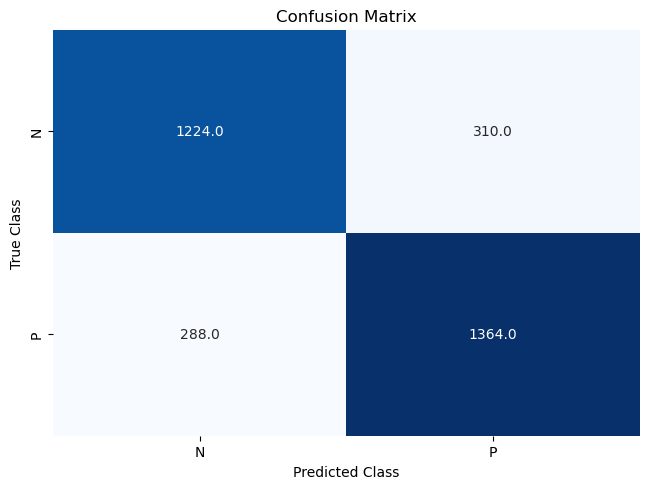

Accuracy :  0.8408662900188324
F1 Score:  0.8459434822242479
Precision:  0.8492983526540574
Recall:  0.8426150121065376
Confuse matrix:
[[1287  247]
 [ 260 1392]]
True positive:  1392
False positive:  247
True negative:  1287
False negative:  260
Sensitivity:  0.8426150121065376
Specificity:  0.8389830508474576


In [166]:

scaler = StandardScaler()
dt_classifier = DecisionTreeClassifier(random_state=0)

pipeline = make_pipeline(scaler, dt_classifier)
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)
dt_cv_results_finished = cross_val_score(pipeline, X_finished, y_finished, cv=kf, scoring="accuracy", n_jobs=-1)

print(dt_cv_results_finished)
print("Mean: ", dt_cv_results_finished.mean())

print(X_test_finished.shape)
print(y_test_finished.shape)

y_pred_finished = cross_val_predict(pipeline, X_test_finished, y_test_finished, cv=10)
conf_mat = confusion_matrix(y_test_finished, y_pred_finished)

plot_conf_matrix(conf_mat)


pipeline.fit(X_train_finished, y_train_finished)

dt_prediction_finished = pipeline.predict(X_test_finished)

# model evaluation
dt_results_finished = eval_model(y_test_finished, dt_prediction_finished)

#### LogisticRegression

[0.77589454 0.76396736 0.78970496 0.76208412 0.76208412 0.75831764
 0.77198492 0.76319095 0.7531407  0.76633166]
Mean:  0.7666700971902828


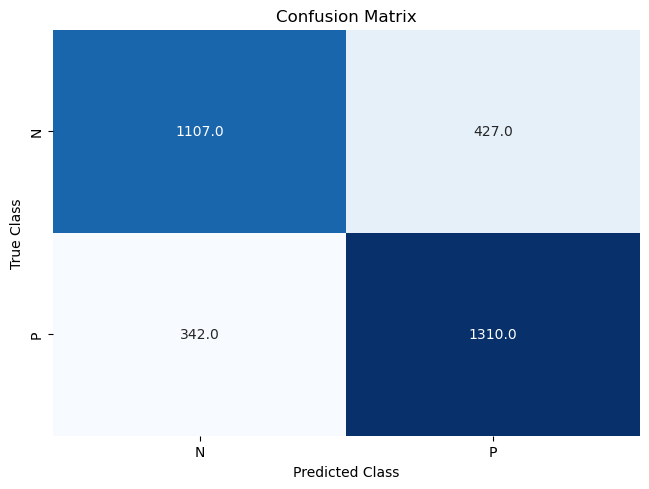

Accuracy :  0.7677338355304457
F1 Score:  0.7772426249247442
Precision:  0.7730538922155689
Recall:  0.7814769975786925
Confuse matrix:
[[1155  379]
 [ 361 1291]]
True positive:  1291
False positive:  379
True negative:  1155
False negative:  361
Sensitivity:  0.7814769975786925
Specificity:  0.7529335071707953


In [171]:

scaler = StandardScaler()
lr_classifier = LogisticRegression(random_state=0)

pipeline = make_pipeline(scaler, lr_classifier)
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)
lr_cv_results_finished = cross_val_score(pipeline, X_finished, y_finished, cv=kf, scoring="accuracy", n_jobs=-1)

print(lr_cv_results_finished)
print("Mean: ", lr_cv_results_finished.mean())

y_pred_finished = cross_val_predict(pipeline, X_test_finished, y_test_finished, cv=10)
conf_mat_finished = confusion_matrix(y_test_finished, y_pred_finished)

plot_conf_matrix(conf_mat_finished)

new_pipe = make_pipeline(scaler, lr_classifier)

new_pipe = new_pipe.fit(X_train_finished, y_train_finished)

lr_prediction_finished = new_pipe.predict(X_test_finished)

# model evaluation
lr_results_finished = eval_model(y_test_finished, lr_prediction_finished)

#### GradientBoost

[0.89642185 0.90018832 0.90144382 0.90269931 0.89516635 0.88512241
 0.88567839 0.88253769 0.8951005  0.90263819]
Mean:  0.8946996832877507


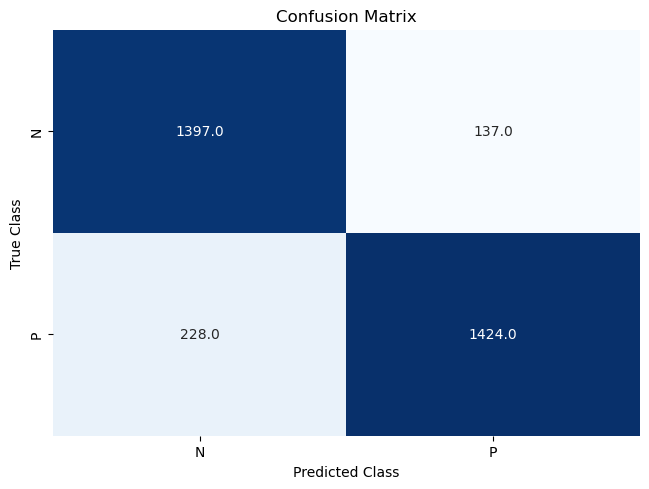

Accuracy :  0.891713747645951
F1 Score:  0.8918834221247258
Precision:  0.9246263807667316
Recall:  0.8613801452784504
Confuse matrix:
[[1418  116]
 [ 229 1423]]
True positive:  1423
False positive:  116
True negative:  1418
False negative:  229
Sensitivity:  0.8613801452784504
Specificity:  0.924380704041721


In [184]:
scaler = StandardScaler()
gb_model = GradientBoostingClassifier(learning_rate=0.1)

pipeline = make_pipeline(scaler, gb_model)
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)
gb_cv_results_finished = cross_val_score(pipeline, X_finished, y_finished, cv=kf, scoring="accuracy", n_jobs=-1)

print(gb_cv_results_finished)
print("Mean: ", gb_cv_results_finished.mean())

y_pred_finished = cross_val_predict(pipeline, X_test_finished, y_test_finished, cv=10)
conf_mat_finished = confusion_matrix(y_test_finished, y_pred_finished)

plot_conf_matrix(conf_mat_finished)

new_pipe = make_pipeline(scaler, gb_model)

new_pipe = new_pipe.fit(X_train_finished, y_train_finished)

gb_prediction_finished = new_pipe.predict(X_test_finished)

# model evaluation
gb_results_finished = eval_model(y_test_finished, gb_prediction_finished)

#### RandomForest

[0.90018832 0.9052103  0.91023227 0.90646579 0.90081607 0.89328311
 0.89761307 0.89698492 0.89949749 0.90515075]
Mean:  0.9015442088029602


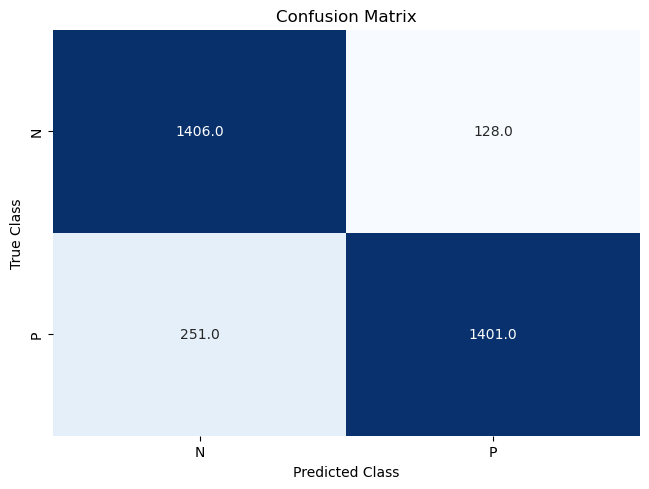

Accuracy :  0.8995605775266792
F1 Score:  0.899812147777082
Precision:  0.9319066147859922
Recall:  0.8698547215496368
Confuse matrix:
[[1429  105]
 [ 215 1437]]
True positive:  1437
False positive:  105
True negative:  1429
False negative:  215
Sensitivity:  0.8698547215496368
Specificity:  0.9315514993481095


In [185]:
scaler = StandardScaler()
rf_model = RandomForestClassifier()

pipeline = make_pipeline(scaler, rf_model)
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)
rf_cv_results_finished = cross_val_score(pipeline, X_finished, y_finished, cv=kf, scoring="accuracy", n_jobs=-1)

print(rf_cv_results_finished)
print("Mean: ", rf_cv_results_finished.mean())

y_pred_finished = cross_val_predict(pipeline, X_test_finished, y_test_finished, cv=10)
conf_mat_finished = confusion_matrix(y_test_finished, y_pred_finished)

plot_conf_matrix(conf_mat_finished)

new_pipe = make_pipeline(scaler, rf_model)

new_pipe = new_pipe.fit(X_train_finished, y_train_finished)

rf_prediction_finished = new_pipe.predict(X_test_finished)

# model evaluation
rf_results_finished = eval_model(y_test_finished, rf_prediction_finished)

### Filtrirani skup podataka

#### LinearSVC

In [162]:
scaler = StandardScaler()
svc_model = LinearSVC()

# create a pipeline that standardizes, that runs LinearSVC
pipeline = make_pipeline(scaler, svc_model)
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)
svc_cv_results_filtered = cross_val_score(pipeline, X_filtered, y_filtered, cv=kf, scoring="accuracy", n_jobs=-1)

print(svc_cv_results_filtered)
print("Mean: ", svc_cv_results_filtered.mean())

pipeline.fit(X_train_filtered, y_train_filtered)

svc_prediction_filtered = pipeline.predict(X_test_filtered)

# model evaluation
svc_results_filtered = eval_model(y_test_filtered, svc_prediction_filtered)

[0.71437539 0.71814187 0.7131199  0.70809793 0.69868173 0.70119272
 0.71670854 0.69974874 0.70351759 0.71168342]
Mean:  0.7085267833202422
Accuracy :  0.7096672944130571
F1 Score:  0.7342717609882218
Precision:  0.6987424822307272
Recall:  0.7736077481840193
Confuse matrix:
[[ 983  551]
 [ 374 1278]]
True positive:  1278
False positive:  551
True negative:  983
False negative:  374
Sensitivity:  0.7736077481840193
Specificity:  0.6408083441981747


#### DecisionTreeClassifier

[0.83176397 0.81418707 0.826742   0.81104834 0.81104834 0.80037665
 0.81155779 0.80213568 0.79773869 0.80967337]
Mean:  0.8116271880431662


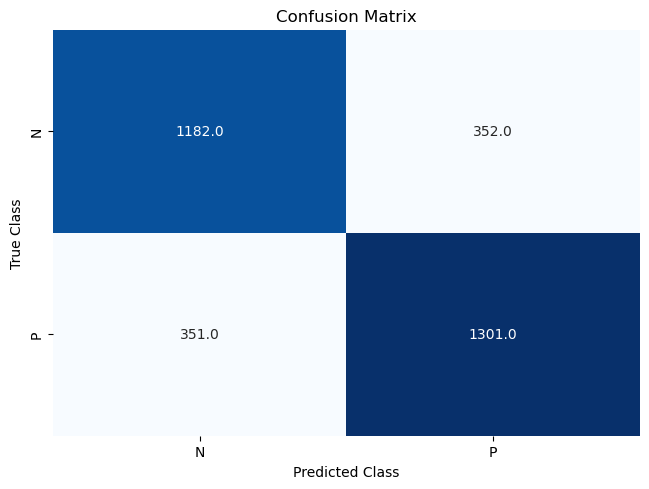

Accuracy :  0.8245448838669177
F1 Score:  0.8281586228097141
Precision:  0.8413491567770144
Recall:  0.8153753026634383
Confuse matrix:
[[1280  254]
 [ 305 1347]]
True positive:  1347
False positive:  254
True negative:  1280
False negative:  305
Sensitivity:  0.8153753026634383
Specificity:  0.834419817470665


In [154]:
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import StratifiedKFold, cross_val_score

scaler = StandardScaler()
dt_classifier = DecisionTreeClassifier(random_state=0)

pipeline = make_pipeline(scaler, dt_classifier)
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)
dt_cv_results_filtered = cross_val_score(pipeline, X_filtered, y_filtered, cv=kf, scoring="accuracy", n_jobs=-1)

print(dt_cv_results_filtered)
print("Mean: ", dt_cv_results_filtered.mean())

y_pred_filtered = cross_val_predict(pipeline, X_test_filtered, y_test_filtered, cv=10)
conf_mat_filtered = confusion_matrix(y_test_filtered, y_pred_filtered)

plot_conf_matrix(conf_mat_filtered)

pipeline.fit(X_train_filtered, y_train_filtered)

rs_prediction_filtered = pipeline.predict(X_test_filtered)

# model evaluation
dt_results_filtered = eval_model(y_test_filtered, rs_prediction_filtered)

#### LogisticRegression

[0.71814187 0.72379159 0.71625863 0.70935342 0.7037037  0.70621469
 0.72550251 0.70477387 0.70540201 0.71733668]
Mean:  0.7130478979959433


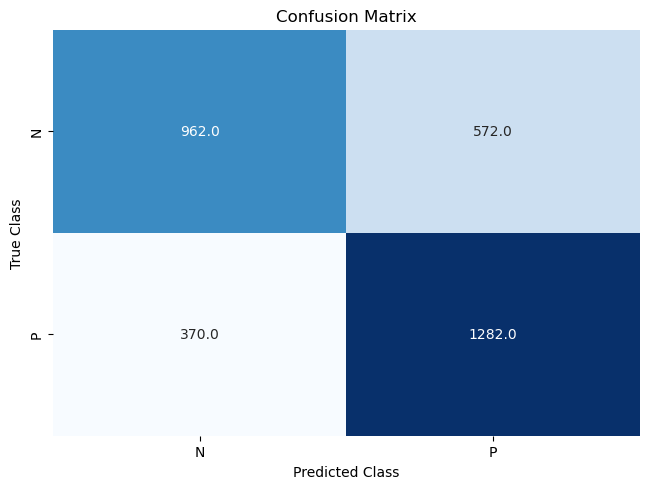

Accuracy :  0.7137476459510358
F1 Score:  0.7353453279164248
Precision:  0.7062430323299889
Recall:  0.7669491525423728
Confuse matrix:
[[1007  527]
 [ 385 1267]]
True positive:  1267
False positive:  527
True negative:  1007
False negative:  385
Sensitivity:  0.7669491525423728
Specificity:  0.6564537157757496


In [173]:

scaler = StandardScaler()
lr_classifier = LogisticRegression(random_state=0)

pipeline = make_pipeline(scaler, lr_classifier)
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)
lr_cv_results_filtered = cross_val_score(pipeline, X_filtered, y_filtered, cv=kf, scoring="accuracy", n_jobs=-1)

print(lr_cv_results_filtered)
print("Mean: ", lr_cv_results_filtered.mean())

y_pred_filtered = cross_val_predict(pipeline, X_test_filtered, y_test_filtered, cv=10)
conf_mat_filtered = confusion_matrix(y_test_filtered, y_pred_filtered)

plot_conf_matrix(conf_mat_filtered)

new_pipe = make_pipeline(scaler, lr_classifier)

new_pipe = new_pipe.fit(X_train_filtered, y_train_filtered)

lr_prediction_filtered = new_pipe.predict(X_test_filtered)

# model evaluation
lr_results_filtered = eval_model(y_test_filtered, lr_prediction_filtered)

#### GradientBoost

[0.8700565  0.87570621 0.87193974 0.86001255 0.86377903 0.85687382
 0.85741206 0.85866834 0.84987437 0.86306533]
Mean:  0.862738795988732


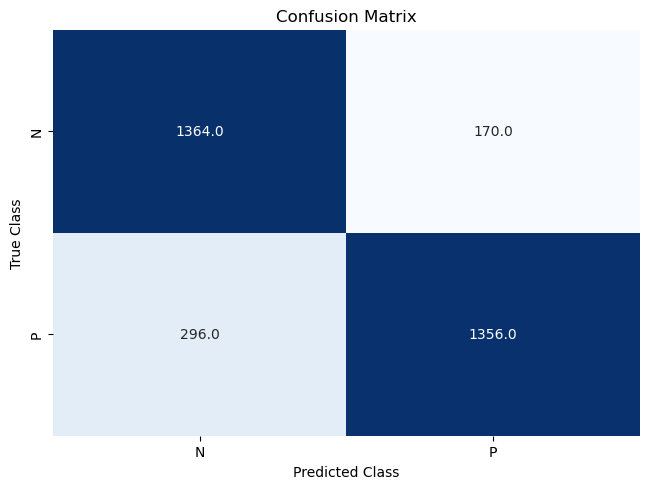

Accuracy :  0.8678593848085373
F1 Score:  0.8630894308943089
Precision:  0.932536893886156
Recall:  0.8032687651331719
Confuse matrix:
[[1438   96]
 [ 325 1327]]
True positive:  1327
False positive:  96
True negative:  1438
False negative:  325
Sensitivity:  0.8032687651331719
Specificity:  0.9374185136897001


In [186]:

scaler = StandardScaler()
gb_model = GradientBoostingClassifier(learning_rate=0.1)

pipeline = make_pipeline(scaler, gb_model)
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)
gb_cv_results_filtered = cross_val_score(pipeline, X_filtered, y_filtered, cv=kf, scoring="accuracy", n_jobs=-1)

print(gb_cv_results_filtered)
print("Mean: ", gb_cv_results_filtered.mean())

y_pred_filtered = cross_val_predict(pipeline, X_test_filtered, y_test_filtered, cv=10)
conf_mat_filtered = confusion_matrix(y_test_filtered, y_pred_filtered)

plot_conf_matrix(conf_mat_filtered)

new_pipe = make_pipeline(scaler, gb_model)

new_pipe = new_pipe.fit(X_train_filtered, y_train_filtered)

gb_prediction_filtered = new_pipe.predict(X_test_filtered)

# model evaluation
gb_results_filtered = eval_model(y_test_filtered, gb_prediction_filtered)

#### RandomForest

[0.85812932 0.84494664 0.83804143 0.83553045 0.8430634  0.8349027
 0.83982412 0.82788945 0.82851759 0.83856784]
Mean:  0.8389412930944742


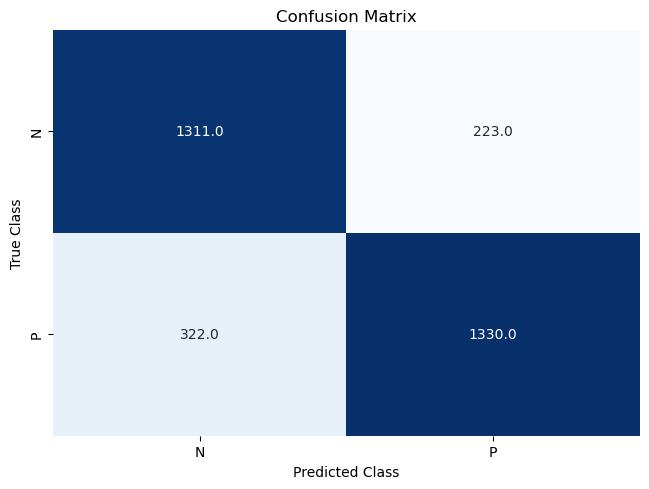

Accuracy :  0.8405524168236033
F1 Score:  0.8424317617866005
Precision:  0.8638676844783715
Recall:  0.8220338983050848
Confuse matrix:
[[1320  214]
 [ 294 1358]]
True positive:  1358
False positive:  214
True negative:  1320
False negative:  294
Sensitivity:  0.8220338983050848
Specificity:  0.8604954367666232


In [187]:

scaler = StandardScaler()
rf_model = RandomForestClassifier()

pipeline = make_pipeline(scaler, rf_model)
kf = StratifiedKFold(n_splits=10, shuffle=True, random_state=1)
rf_cv_results_filtered = cross_val_score(pipeline, X_filtered, y_filtered, cv=kf, scoring="accuracy", n_jobs=-1)

print(rf_cv_results_filtered)
print("Mean: ", rf_cv_results_filtered.mean())

y_pred_filtered = cross_val_predict(pipeline, X_test_filtered, y_test_filtered, cv=10)
conf_mat_filtered = confusion_matrix(y_test_filtered, y_pred_filtered)

plot_conf_matrix(conf_mat_filtered)

new_pipe = make_pipeline(scaler, rf_model)

new_pipe = new_pipe.fit(X_train_filtered, y_train_filtered)

rf_prediction_filtered = new_pipe.predict(X_test_filtered)

# model evaluation
rf_results_filtered = eval_model(y_test_filtered, rf_prediction_filtered)

## REZULTATI

#### LinearSVC

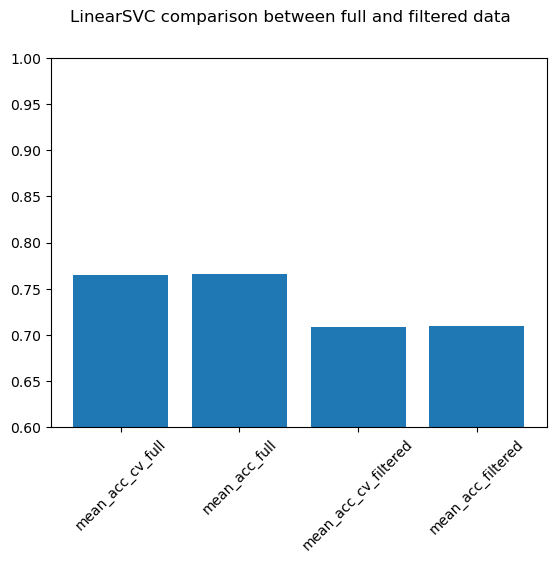

,model,accuracy
1,mean_acc_cv_full,0.765163
2,mean_acc_full,0.766478
3,mean_acc_cv_filtered,0.708527
4,mean_acc_filtered,0.709667


In [165]:
#plt.figure(figsize=(5, 3))
plt.ylim(0.6, 1.00)
plt.bar(['mean_acc_cv_full', "mean_acc_full", "mean_acc_cv_filtered", 'mean_acc_filtered'], [svc_cv_results_finished.mean(), svc_results_finished, svc_cv_results_filtered.mean(), svc_results_filtered])
plt.suptitle('LinearSVC comparison between full and filtered data')
plt.xticks(rotation=45)
plt.show()

data_table=pd.DataFrame(columns=['model','accuracy'])
    
data_table.loc[1] = ["mean_acc_cv_full", svc_cv_results_finished.mean()]
data_table.loc[2] = ["mean_acc_full", svc_results_finished]
data_table.loc[3] = ["mean_acc_cv_filtered", svc_cv_results_filtered.mean()]
data_table.loc[4] = ["mean_acc_filtered", svc_results_filtered]

data_table.head()


#### DecisionTreeClasifier

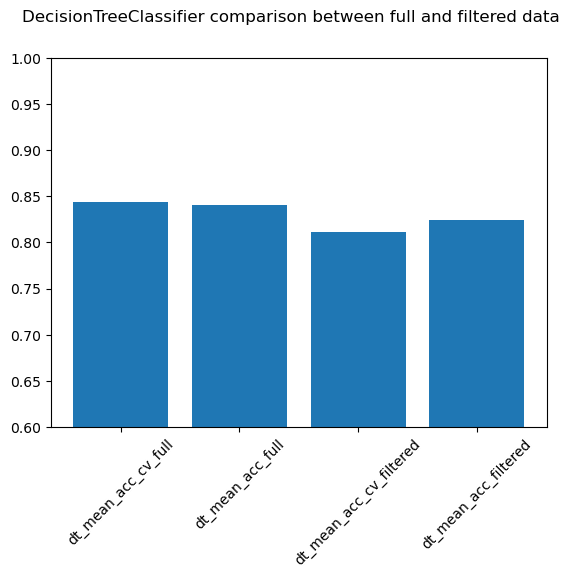

,model,accuracy
1,dt_mean_acc_cv_full,0.843525
2,dt_mean_acc_full,0.840866
3,dt_mean_acc_cv_filtered,0.811627
4,dt_mean_acc_filtered,0.824545


In [168]:
#plt.figure(figsize=(5, 3))
plt.ylim(0.6, 1.00)
plt.bar(['dt_mean_acc_cv_full', 'dt_mean_acc_full', 'dt_mean_acc_cv_filtered', 'dt_mean_acc_filtered'], [dt_cv_results_finished.mean(), dt_results_finished, dt_cv_results_filtered.mean(), dt_results_filtered.mean()])
plt.suptitle('DecisionTreeClassifier comparison between full and filtered data')
plt.xticks(rotation=45)
plt.show()

data_table_dt=pd.DataFrame(columns=['model','accuracy'])
    
data_table_dt.loc[1] = ["dt_mean_acc_cv_full", dt_cv_results_finished.mean()]
data_table_dt.loc[2] = ["dt_mean_acc_full", dt_results_finished]
data_table_dt.loc[3] = ["dt_mean_acc_cv_filtered", dt_cv_results_filtered.mean()]
data_table_dt.loc[4] = ["dt_mean_acc_filtered", dt_results_filtered]

data_table_dt.head()

#### LogisticRegression

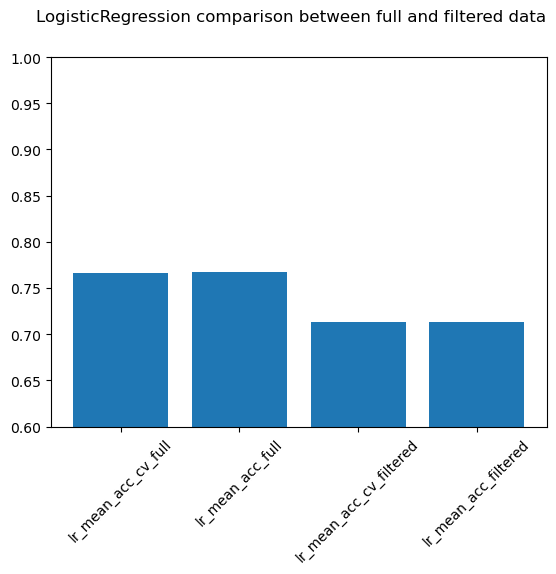

,model,accuracy
1,lr_mean_acc_cv_full,0.766670
2,lr_mean_acc_full,0.767734
3,lr_mean_acc_cv_filtered,0.713048
4,lr_mean_acc_filtered,0.713748


In [174]:
#plt.figure(figsize=(5, 3))
plt.ylim(0.6, 1.00)
plt.bar(['lr_mean_acc_cv_full', 'lr_mean_acc_full', 'lr_mean_acc_cv_filtered', 'lr_mean_acc_filtered'], [lr_cv_results_finished.mean(), lr_results_finished, lr_cv_results_filtered.mean(), lr_results_filtered.mean()])
plt.suptitle('LogisticRegression comparison between full and filtered data')
plt.xticks(rotation=45)
plt.show()

data_table_lr=pd.DataFrame(columns=['model','accuracy'])
    
data_table_lr.loc[1] = ["lr_mean_acc_cv_full", lr_cv_results_finished.mean()]
data_table_lr.loc[2] = ["lr_mean_acc_full", lr_results_finished]
data_table_lr.loc[3] = ["lr_mean_acc_cv_filtered", lr_cv_results_filtered.mean()]
data_table_lr.loc[4] = ["lr_mean_acc_filtered", lr_results_filtered]

data_table_lr.head()

#### GradientBoost

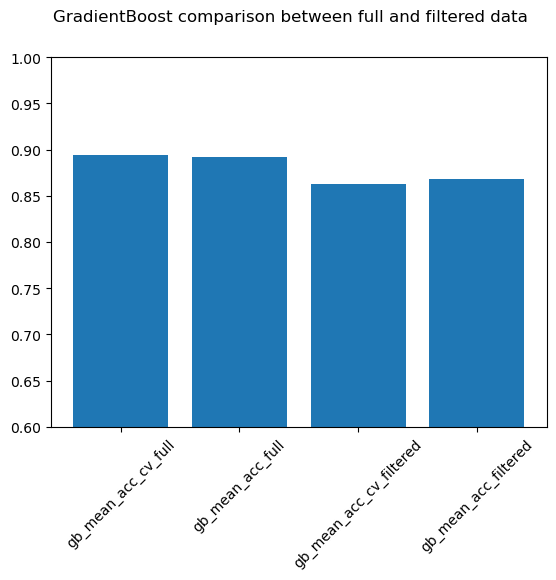

,model,accuracy
1,gb_mean_acc_cv_full,0.894700
2,gb_mean_acc_full,0.891714
3,gb_mean_acc_cv_filtered,0.862739
4,gb_mean_acc_filtered,0.867859


In [190]:
#plt.figure(figsize=(5, 3))
plt.ylim(0.6, 1.00)
plt.bar(['gb_mean_acc_cv_full', 'gb_mean_acc_full', 'gb_mean_acc_cv_filtered', 'gb_mean_acc_filtered'], [gb_cv_results_finished.mean(), gb_results_finished, gb_cv_results_filtered.mean(), gb_results_filtered.mean()])
plt.suptitle('GradientBoost comparison between full and filtered data')
plt.xticks(rotation=45)
plt.show()

data_table_gb=pd.DataFrame(columns=['model','accuracy'])
    
data_table_gb.loc[1] = ["gb_mean_acc_cv_full", gb_cv_results_finished.mean()]
data_table_gb.loc[2] = ["gb_mean_acc_full", gb_results_finished]
data_table_gb.loc[3] = ["gb_mean_acc_cv_filtered", gb_cv_results_filtered.mean()]
data_table_gb.loc[4] = ["gb_mean_acc_filtered", gb_results_filtered]

data_table_gb.head()

#### RandomForest

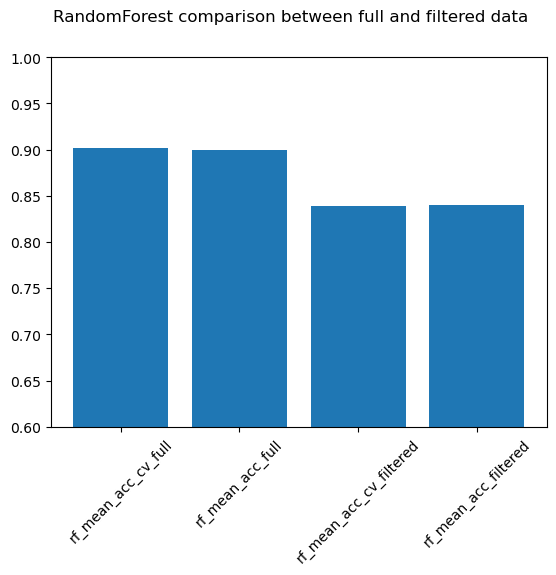

,model,accuracy
1,rf_mean_acc_cv_full,0.901544
2,rf_mean_acc_full,0.899561
3,rf_mean_acc_cv_filtered,0.838941
4,rf_mean_acc_filtered,0.840552


In [191]:
#plt.figure(figsize=(5, 3))
plt.ylim(0.6, 1.00)
plt.bar(['rf_mean_acc_cv_full', 'rf_mean_acc_full', 'rf_mean_acc_cv_filtered', 'rf_mean_acc_filtered'], [rf_cv_results_finished.mean(), rf_results_finished, rf_cv_results_filtered.mean(), rf_results_filtered.mean()])
plt.suptitle('RandomForest comparison between full and filtered data')
plt.xticks(rotation=45)
plt.show()

data_table_rf=pd.DataFrame(columns=['model','accuracy'])
    
data_table_rf.loc[1] = ["rf_mean_acc_cv_full", rf_cv_results_finished.mean()]
data_table_rf.loc[2] = ["rf_mean_acc_full", rf_results_finished]
data_table_rf.loc[3] = ["rf_mean_acc_cv_filtered", rf_cv_results_filtered.mean()]
data_table_rf.loc[4] = ["rf_mean_acc_filtered", rf_results_filtered]

data_table_rf.head()

# ZAKLJUČAK

Prema gore pokazanim primerima raspodele podataka i izračunavanjima različitih vrednosti kvaliteta podataka, neophodno je napomenuti sledeće zaključke: 


1) Na osnovu pozicioniranja krive prilikom procesa RASPODELE PODATAKA moguće je otkriti i pronaći "outlier" vrednosti u podacima. OUTLIER vrednosti predstavljaju vrednosti koje odstupaju od opsega većine podataka i sa njima se treba vrlo pažljivo rukovati kako bi se kreirani model mašinskog učenja što bolje prilagodio domenu problema koji se rešava. 

    - OUTLIER vrednosti mogu predstavljati pogrešne vrednosti koje negativno utiču na uspešnost predikcije modela mašinskog učenja pri čemu:
        
        - kod KLASIFIKACIJE utiču smanjivanjem verovatnoće preciznosti predikcije samog objekta nad kojim se vrši predikcija i time smanjuje uspešnost samog algoritma
        
        - kod REGRESIJE negativno utiču na tačnost i pouzdanost modela prilikom određivanja regresione linije koja treba najbolje opisati relacije između zavisnih i nezavisnih promenljivih. Obzirom da  su ove "outlier" vrednosti  udaljene od ostalih podataka, to značajno utiče na nepravilnu prilagođenost regresione krive samim posmatranim podacima. Kako bismo ovakvo negativno prilagođavanje otklonili, neophodno je pre same faze treniranja modela ukloniti "outlier" vrednosti ili primeniti regresione metode koje su manje osetljive na te vrednosti

2) Na osnovu MATRICE KORELACIJE možemo doneti sledeće zaključke:
    
    - Obzirom da korelacija predstavlja meru uslovljenosti promene vrednosti između dva atributa u posmatranom skupu podataka, možemo jasno uočiti koji atributi jesu, a koji atributi nisu zavisni od ostalih. Imajući u obzir zavisnosti u podacima, jasno se može utvrditi da slabo uslovljeni atributi ne utiču na konačnu vrednost zavisnosti izlaznog podatka i da je takve podatke moguće izbaciti. Zavisne atribute je poželjno uključiti u skup podataka koji se koristi za treniranje modela mašinskog učenja jer se izlazna vrednost modela treba utvrditi na osnovu većeg broja zavisnih atributa koji modeluju takav izlaz 
    
3) Na osnovu VREDNOSTI VARIJANSE možemo doneti sledeće zaključke:

    - Kako vrednost varijanse raznih atributa može imati različite opsege vrednosti, a obzirom da se ta vrednost drastično razlikuje od ostalih vrednosti varijanse atributa, najpre je neophodno izvršiti analizu varijanse svakog pojedinačnog atributa. Ukoliko je vrednost varijanse veoma niska, takvi atributi ne predstavljaju kvalitetan atribut na osnovu kojeg se može doneti određena zakonitost o promeni zavisnih vrednosti. Ukoliko je vrednost varijanse veoma visoka, može doći do Overfitting-a što predstavlja preveliko prilagođavanje vrednostima iz skupa sa velikom varijansom. Prilikom overfitting-a, model se previše prilagođava podacima za koje je treniran, pri čemu se ne može dobro generalizovati i primeniti nad novim podacima. Ukoliko nemamo dovoljnu količinu dostupnih podataka, a imamo visok šum ili varijaciju u tim podacima, dolazi do pretreniranosti modela i do donošenja neispravnih zaključaka prilikom primene tog modela nad novim ulaznim podacima.